# A Bayesian Approach to Final Adjusted Values

In this workbook we are going to estimate final adjusted values (FAVs) for a list of compounds using the Bayesian approach outlined in Rodgers et al. (2021). FAVs are physical-chemical property values adjusted for thermodynamic consistency, as each of the properties can be expressed as a combination of the other properties (Cole and Mackay, 2000; Beyer et al., 2002). The properties of interest are as follows:
### Solubilities
Subcooled liquid vapour pressure (PL/Pa) - converted to subcooled liquid air solubility (SAL/mol m-3) as SAL = PL/RT (Cole & Mackay, 2000)<br>
Subcooled liquid water solubilty (SWL/mol m-3)<br>
Subcooled liquid octanol solubility (SOL/mol m-3)
### Dimensionless Partition Coefficients
Octanol/Water partition coefficient (KOW)<br>
Octanol/Air partition coefficient (KOA)<br>
Air/Water partition coefficent (KAW) - can be derived from Henry's law constant (H/Pa m3 mol-1) as KAW = H/RT<br>

The properties are related as:<br>
$logKaw = logSa - logSw$ (1)<br>
$log Koa = logSo - logSa$ (2)<br>
$logKow = logSo - logSw$ (3) (note that this is dry octanol Kow)<br>
$logSo/Sw = logSo-logSw $(4)<br>
From this, we can derive a set of equation which gives the "misclosure error" (w) between the data points, where w is 0 in a completely consistent data set, such as our FAVs, as (Schenker et al., 2005):<br>
$logKaw - logKow + logKoa = w0$ (5)<br>
then we can adjust these values with an adjustment, ei, where (if the relative uncertainty between the values is equal) 
$w0 = e1-e2+e3$ (6) (for the equation above) such that:<br>
$FAVKaw = logKaw-ev1$ (7)<br>
$FAVKow = logKow-e2$ (8)<br>
$FAVKoa = logKoa-e3$ (9)<br>
This system can be extended so that instead of a single equation (5) we have a system of equations, based on (1)-(4) as:<br>
$log(Sa) - log(Sw) -log(Kaw) = w1$ (10)<br>
$log(Sa) - log(So) + log(Koa) = w2$ (11)<br>
$log(Sw) - log(So) + log(Kow) = w3$(12) (note that this is dry octanol Kow)<br>

The temperature dependence of these properties (K or S) can be estimated over a small temperature gradient using a modified Van't Hoff equation as $ln(K/S(T2)) = ln(K/S(T1))- dU/R(1/T2-1/T1)$, where dU is the internal energy of phase change. All values entered into the model should be at 25°C. This paper has used properties corrected from within 5°C of that value (20 - 30 °C, inclusive) to derive the LDVs, unless otherwise noted. 

These internal energy values can also be adjusted, using a similar set of equations to the above (Beyer et al., 2002):<br>
$dUaw - dUow +dUoa = w4$ (13a) or equivalently $dUa - dUw -dUow +dUoa = w4$ (13b).<br>

## Interactive Notebook Overview

This notebook will walk through this approach, providing an open-source tool for anyone familiar with basic Python. This notebook will use the data from Rodgers et al. (2021), which is included with this notebook on Github. Users can replace this with their own data, as long as it follows the same format (or feel free to change the code). We will be making two sets of FAVs here - FAVLs, which are based only on literature measured values, and FAVRs, which supplement the literature measured values with in-silico property estimations where measurements are unavailable, to provide a complete set of recommended values for each compound. 

The layout of this notebook will be as follows:
1. Estimate FAVLs for the internal energies using only literature measured values as priors
    1a. Check consistency, assess bias of adjustments
    1b. Evaluate in-silico estimates vs FAVLs & LDVs (where necessary) to select best in-silico estimations for each property by compound class
2. Estimate FAVRs for the internal energies using LDVs & best in-silico values as priors
    2a. Check consistency, assess bias of adjustments
    2b. Use FAVRs to adjust the partition coefficient and solubility measurements to 298.15 K (not shown, done in Excel)
3. Estimate FAVLs for the partition coefficients & solubilities using only literature measured values as priors
    3a. Check consistency, assess bias of adjustments
    3b. Evaluate in-silico estimates vs FAVLs & LDVs (where necessary) to select best in-silico estimations for each property by compound class
4. Estimate FAVRs for the partition coefficients & solubilites using LDVs & best in-silico values as priors
    4a. Check consistency, assess bias of adjustments
    
Individual cells below can be run by clicking in the cell and pressing shift + enter. More details regarding the Jupyter Notebook interface can be found using the following link: https://jupyter-notebook.readthedocs.io/en/stable/

### Refs: 
Rodgers et al. (2021):<br>
Cole and Mackay, 2000: Cole, J. G. and Mackay, D.: Correlating environmental partitioning properties of organic compounds: The three solubility approach, Environ. Toxicol. Chem., 19(2), 265–270, doi:10.1002/etc.5620190203, 2000.<br>
Beyer et al., 2002: Beyer, A., Wania, F., Gouin, T., Mackay, D. and Matthies, M.: Selecting Internally Consistent Physicochemical Properties of Organic Compounds, Environ. Toxicol. Chem., 21(5), 941–953, doi:10.1002/etc.5620210508, 2002.<br>

## Step 0: Import the Data & Model Functions
The Bayesian FAV Tutorial directory, which contains the Python code (.py extension), must be in the same parent directory as this Jupyter notebook file. You can find the model and all supporting datafiles at https://github.com/tfmrodge/Bayesian_FAV_Tutorial

This project uses some packages that are not part of the standard Anaconda distribtuion. Please follow the instructions at the respective packages' webpages for instructions on how to install: <br>
Uncertainties - https://uncertainties-python-package.readthedocs.io/en/latest/ <br>
PyMC3 (typically included in Conda) - https://docs.pymc.io/

### Editing the Input Files
This notebook relies on two key input files to function. Workbooks are denoted by **bold text** and sheets within workbooks are denoted by *italics*:
1. **LDV_Data** - This file contains the literature derived values from meassured data only. The first four columns give compound identifiers: the class of compounds, the original order they were presented, the compound name, and the compound's CAS number. Next, there are three columns for each property representing the LDV central tendency, standard deviation, and number of literature values for each compound/property pair. The final six columns contain information on the entropy of fusion (dSfus) and the melting point (Tm), neither of which is used in the harmonization process. The **Rodgers et al. SI and Data Template** workbook contains an output spreadsheet that will be automatically populated in the correct format (described below).
2. **LDVMDV_Data** - This file contains the combined in silico and literature derived values (in silico estimations are given a value of 0.5). The first four columns give compound identifiers: the class of compounds, the original order they were presented, the compound name, and the compound's CAS number. Next, there are three columns for each property representing the LDV central tendency, standard deviation, and number of literature values for each compound/property pair. The final six columns contain information on the entropy of fusion (dSfus) and the melting point (Tm), neither of which is used in the harmonization process. The **Rodgers et al. SI and Data Template** workbook contains an output spreadsheet that will be automatically populated in the correct format (described below).

To use this notebook with your own data, the Excel (.xlsx) workbook template provided as **Rodgers et al. SI and Data Template** will guide you through the data entry process and provide formatted outputs that can be copy and pasted into the input data files. A short description of each worksheet and its use follows:
1. *Table S2 Compound Identifiers* - contains a list of all chemicals, along with their compound class and other identifiers. The names, classes & CAS numbers from this sheet are used to generate the LDV_data and LDV_MDV_data output sheets; the other columns are not used further
2. *Table S3 Literature Values* - This sheet contains all of the literature measured values and the Literature Derived Values (LDVs). For each compound, the name should be in the "A" column, with the CAS number and the molecular weight in the B column (CAS above molecular weight). For each property, the leftmost column contains the values that will be pulled into the outputs and so used in this notebook. For each property, the first row contains the central tendency, the second row the standard deviation and the bottom row the number of literature values. To enter your own data, put your own data in each of the properties as per the template. Additional rows can be added without issue but the columns should not be adjusted. The name in the A column is used to pull the data, this must be the same as the name in "Table S2" for the outputs to work.
3. *Table S4 Conversions and Notes* - This sheet contains the calculations used to generate the LDVs. The top table contains the calculations for the fugacity ratio (F), based on the dSfus LDVs in "Table S3" or a default value. The table below contains temperature conversions (to 298K from the temperature of measurement) and the subcooled-liquid state conversions using the fugacity ration calculated above. 
4. *Table S5 Measurement References* - This table contains the references for the literature measurements in Table S3. This is for reference; these entries do not impact any calculations.
5. *Table S6 Recommended Values* - This table contains the FAVLs, the FAVRs, the LDVs and the Model Derived Values (MDVs). This table must be updated manually.
6. *Table S9 Model Derived Values* - This contains the model derived values (MDVs). These must be input in the same manner as the LDVs.
7. *LDV Output* - This contains the output data for the LDVs, used to calculate the literature FAVs (FAVLs). It is linked to Table S3, and is the input for this notebook. The compound names are linked to Table S2. To use this data, copy and paste the values into the **LDV_Data** workbook.
8. *LDV_MDV Output* - This contains the output data for the MDVs and LDVs, used to calculate the recommended FAVs (FAVRs). It is linked to Table S3, and is the input for the "part 2" notebook. To use this data, copy and paste the values into the **LDVMDV_Data** workbook.

In [1]:
#Import necessary Python packages
import uncertainties
import pandas as pd
import pymc3 as pm
import pdb
import os
from IPython.core.interactiveshell import InteractiveShell
#This contains the FAV model set-up and display functions. For more details or for help with variable names/inputs
#etc, look at the function definitions and in-line comments. The "FAV_model_funcs.py" file must be in the same
#folder as this notebook
import FAV_model_funcs as fmf
#Load Data
LDV = pd.read_excel('LDV_Data.xlsx', index_col = 2)
uLDV,FAVs = fmf.loaddata(LDV)
#Display the header column of the uLDV.
uLDV.head()

D:\Anaconda3\lib\site-packages\distributed\config.py:63: YAMLLoadWarning: calling yaml.load() without Loader=... is deprecated, as the default Loader is unsafe. Please read https://msg.pyyaml.org/load for full details.
  config.update(yaml.load(text) or {})


,dVAPH,dUW,dUO,dUOA,dUAW,dUOW,LogKOA,LogKOW,LogKAW,LogPL,...,nKS_absent,w_dUAW,w_dUOW,w_dUOA,w_Ks,w4,w5,w_KAW,w_KOW,w_KOA
Compound Name,,,,,,,,,,,,,,,,,,,,,
cyclopentadecanone,65+/-12,NaN,NaN,-35.5+/-2.2,NaN,NaN,6.59+/-0.17,5.7+/-1.1,NaN,-0.3+/-0.4,...,2,nan+/-12.406667724169532,NaN,nan+/-12.608899972750773,NaN,-0.3+/-1.3,-0.7+/-1.6,NaN,NaN,NaN
15-pentadecanolide,77.0+/-2.5,NaN,NaN,NaN,NaN,NaN,NaN,5.8+/-0.6,NaN,-1.08+/-0.06,...,3,nan+/-2.506990594164016,NaN,nan+/-2.506990594164016,NaN,NaN,NaN,NaN,NaN,NaN
Musk Ambrette,80+/-6,48+/-14,NaN,-69.0+/-2.8,NaN,2.5+/-0.7,8.03+/-0.11,4.21+/-0.29,NaN,-1.23+/-0.19,...,2,nan+/-15.487879511328744,nan+/-14.430796605938978,nan+/-6.308119700548489,NaN,1.7+/-0.5,1.8+/-0.5,NaN,NaN,NaN
16-hexadecanolide,73+/-10,NaN,NaN,-52.3+/-3.3,NaN,NaN,7.31+/-0.19,7.3+/-1.5,NaN,-1.1+/-0.4,...,2,nan+/-9.76165969494937,NaN,nan+/-10.308740421395354,NaN,-1.2+/-1.6,-2.2+/-2.1,NaN,NaN,NaN
Celestolide,NaN,-22+/-7,NaN,-65+/-4,NaN,0.059+/-0.018,7.58+/-0.20,5.7+/-1.1,NaN,-0.78+/-0.12,...,2,nan+/-6.569835952594274,nan+/-6.569859457119444,nan+/-4.11193963734019,NaN,-0.9+/-1.2,-1.4+/-1.6,NaN,NaN,NaN


## Step 3: Estimate FAVLs for the partition coefficients & solubilities (KS)
First, we will calculate the literature-only FAVs (FAVLs) for the partition coefficients & solubilities (KS). To start off we will look at what properties are missing from the different compounds. As in the dUs file, the "nKS_absent" variable records how many partition coefficients and solubilities are missing for each compound, and is calculated automatically. Below, we have limited to <3 properties missing, as generating an FAV requires at 3 or more propertiesdepending on which properties are present

In [10]:
#Define the number of missing enthalpies to display
numKS_absent = 0
uLDV.loc[uLDV.nKS_absent<=numKS_absent,'LogSA_absent':'LogKOA_absent']
#You can see that there are more compounds where FAVs are possible for the KS than for the dUs. 

,LogSA_absent,LogSW_absent,LogSO_absent,LogKAW_absent,LogKOW_absent,LogKOA_absent
Compound Name,,,,,,
"p,p'- DDE",False,False,False,False,False,False
benzo[a]pyrene,False,False,False,False,False,False


This time we won't bother running a single compound. We will loop through all of our compounds with >3 properties
generating FAVs for all where it is possible. In some cases even with >3 properties it won't be possible
e.g. if you have LogSA, LogSW and LogSo there is no way to get a misclosure error, and therefore we won't calculate FAVs. Note that runnning the KS model takes less time than the dUs, but can still take quite a while. 

In [11]:
#Define the compounds that will be tried - here we loop through everything with more than three properties.
numUs_absent = 3
compounds = uLDV[uLDV.nUs_absent<=numUs_absent].index
#If you want to run a specific compound/list of compounds, comment out the above line and run the following:
#comps = ['Musk Ambrette']
for compound in compounds:
    #pdb.set_trace()
    #For some compounds we can't make an FAV. This will raise a "ValueError", and we will skip that compound.
    try:
        FAVs, enth_trace = fmf.run_model(compound,FAVs,model_type ='KS',uDV = uLDV,
                                         trace = 100, tune=100,target_accept=0.9)
    except ValueError:
        pass

Only 100 samples in chain.
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (5 chains in 5 jobs)
NUTS: [LogKOA, LogKOWd, LogKAW, LogSW, LogSA, sigma]
Sampling 5 chains, 0 divergences: 100%|████████████████████████████████████████| 1000/1000 [00:09<00:00, 100.12draws/s]
The acceptance probability does not match the target. It is 0.47409056989433557, but should be close to 0.9. Try to increase the number of tuning steps.
The acceptance probability does not match the target. It is 0.6976963009923911, but should be close to 0.9. Try to increase the number of tuning steps.
The acceptance probability does not match the target. It is 0.6709538922321294, but should be close to 0.9. Try to increase the number of tuning steps.
The rhat statistic is larger than 1.2 for some parameters.
The estimated number of effective samples is smaller than 200 for some parameters.
Only 100 samples in chain.
Auto-assigning NUTS sampler...
Initializing NUTS using 

Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (5 chains in 5 jobs)
NUTS: [LogKOA, LogKOWd, LogKAW, LogSO, LogSW, LogSA, sigma]
Sampling 5 chains, 0 divergences: 100%|████████████████████████████████████████| 1000/1000 [00:09<00:00, 104.29draws/s]
The estimated number of effective samples is smaller than 200 for some parameters.
Only 100 samples in chain.
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (5 chains in 5 jobs)
NUTS: [LogKOA, LogKOWd, LogKAW, LogSO, LogSW, LogSA, sigma]
Sampling 5 chains, 0 divergences: 100%|█████████████████████████████████████████| 1000/1000 [00:10<00:00, 95.97draws/s]
The acceptance probability does not match the target. It is 0.7675581437115881, but should be close to 0.9. Try to increase the number of tuning steps.
The rhat statistic is larger than 1.05 for some parameters. This indicates slight problems during sampling.
The estimated number of effective samples is smaller than 200 f

In [14]:
#For some reason this needs to be done outside of the cell.
InteractiveShell.ast_node_interactivity = 'all' 

'aldrin'

,mean,sd,hpd_3%,hpd_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
LogSA,-5.014,0.151,-5.276,-4.742,0.009,0.006,313.0,312.0,305.0,327.0,1.00
LogSW,-2.511,0.148,-2.814,-2.253,0.008,0.006,334.0,331.0,332.0,263.0,1.01
LogKAW,-2.534,0.139,-2.817,-2.291,0.008,0.005,339.0,334.0,332.0,289.0,1.02
LogKOWd,5.820,0.195,5.478,6.235,0.011,0.008,295.0,294.0,300.0,280.0,1.02
LogKOA,8.289,0.134,8.052,8.522,0.009,0.006,242.0,242.0,241.0,283.0,1.02
sigma,0.010,0.006,0.001,0.021,0.001,0.000,90.0,90.0,51.0,62.0,1.10
LogSO,3.292,0.217,2.897,3.687,0.015,0.011,213.0,194.0,211.0,237.0,1.02


'BDE-47'

,mean,sd,hpd_3%,hpd_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
LogSA,-7.115,0.192,-7.434,-6.737,0.014,0.010,188.0,188.0,189.0,193.0,1.02
LogSW,-4.070,0.076,-4.209,-3.934,0.003,0.002,585.0,585.0,596.0,346.0,1.02
LogKOWd,7.390,0.267,6.912,7.949,0.020,0.014,178.0,177.0,178.0,192.0,1.02
LogKOA,10.434,0.143,10.155,10.672,0.009,0.006,284.0,283.0,281.0,251.0,1.02
sigma,0.008,0.006,0.001,0.019,0.000,0.000,165.0,165.0,128.0,148.0,1.03
LogKAW,-3.042,0.211,-3.422,-2.627,0.015,0.011,186.0,186.0,189.0,188.0,1.02


'BDE-99'

,mean,sd,hpd_3%,hpd_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
LogSA,-7.765,0.244,-8.243,-7.321,0.014,0.010,300.0,300.0,301.0,284.0,1.02
LogSW,-4.346,0.269,-4.870,-3.841,0.016,0.011,286.0,286.0,289.0,257.0,1.02
LogKOWd,7.820,0.352,7.066,8.420,0.025,0.017,206.0,206.0,215.0,227.0,1.02
LogKOA,11.230,0.154,10.949,11.544,0.008,0.006,374.0,374.0,383.0,290.0,1.00
sigma,0.009,0.006,0.001,0.019,0.000,0.000,142.0,142.0,100.0,25.0,1.04
LogKAW,-3.419,0.338,-4.037,-2.787,0.020,0.015,272.0,268.0,273.0,190.0,1.01


'benzo[a]pyrene'

,mean,sd,hpd_3%,hpd_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
LogSA,-8.473,0.348,-9.174,-7.862,0.023,0.016,229.0,228.0,235.0,240.0,1.01
LogSW,-4.176,0.241,-4.591,-3.723,0.015,0.010,272.0,272.0,271.0,220.0,1.02
LogSO,2.511,0.280,1.981,3.033,0.018,0.013,233.0,232.0,234.0,324.0,1.02
LogKAW,-4.296,0.360,-4.931,-3.643,0.025,0.018,207.0,207.0,207.0,218.0,1.02
LogKOWd,6.686,0.265,6.254,7.284,0.017,0.012,244.0,243.0,245.0,254.0,1.01
LogKOA,10.989,0.320,10.427,11.577,0.025,0.018,159.0,159.0,157.0,293.0,1.04
sigma,0.010,0.006,0.001,0.020,0.000,0.000,152.0,152.0,117.0,101.0,1.03


'Celestolide'

,mean,sd,hpd_3%,hpd_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
LogSA,-4.159,0.223,-4.568,-3.759,0.014,0.010,265.0,265.0,266.0,389.0,1.02
LogSW,-1.357,0.243,-1.761,-0.807,0.018,0.013,181.0,181.0,182.0,188.0,1.02
LogKOWd,4.800,0.421,3.944,5.539,0.040,0.028,113.0,113.0,114.0,296.0,1.05
LogKOA,7.598,0.238,7.144,8.036,0.017,0.012,200.0,200.0,200.0,312.0,1.03
sigma,0.008,0.006,0.001,0.018,0.001,0.000,91.0,91.0,70.0,122.0,1.04
LogKAW,-2.803,0.330,-3.450,-2.216,0.025,0.018,172.0,166.0,173.0,216.0,1.02


'Di-n-butyl phthalate'

,mean,sd,hpd_3%,hpd_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
LogSA,-5.726,0.132,-5.959,-5.482,0.008,0.006,261.0,261.0,261.0,275.0,1.01
LogSW,-1.398,0.063,-1.511,-1.281,0.003,0.002,584.0,582.0,584.0,405.0,1.01
LogKAW,-4.325,0.158,-4.572,-4.000,0.011,0.007,226.0,225.0,224.0,292.0,1.02
LogKOWd,4.365,0.243,3.894,4.786,0.017,0.012,209.0,209.0,211.0,233.0,1.02
LogKOA,8.686,0.210,8.315,9.058,0.014,0.010,227.0,227.0,228.0,259.0,1.01
sigma,0.011,0.006,0.002,0.023,0.001,0.001,37.0,37.0,27.0,68.0,1.14
LogSO,2.967,0.238,2.503,3.404,0.016,0.012,211.0,211.0,216.0,239.0,1.02


'Galaxolide 1'

,mean,sd,hpd_3%,hpd_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
LogSA,-4.560,0.123,-4.784,-4.314,0.008,0.006,228.0,228.0,227.0,285.0,1.02
LogSW,-2.178,0.074,-2.302,-2.031,0.004,0.003,401.0,395.0,404.0,282.0,1.01
LogKAW,-2.363,0.152,-2.646,-2.084,0.010,0.007,213.0,213.0,220.0,192.0,1.02
LogKOWd,5.688,0.242,5.208,6.101,0.026,0.018,90.0,88.0,100.0,128.0,1.05
LogKOA,8.058,0.184,7.682,8.372,0.015,0.011,142.0,142.0,123.0,284.0,1.05
sigma,0.011,0.007,0.001,0.022,0.001,0.001,68.0,68.0,42.0,22.0,1.09
LogSO,3.505,0.229,3.113,3.919,0.022,0.016,112.0,107.0,119.0,155.0,1.05


'Moskene'

,mean,sd,hpd_3%,hpd_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
LogSA,-5.714,0.622,-6.823,-4.538,0.055,0.039,127.0,127.0,124.0,204.0,1.03
LogSW,-2.997,0.516,-4.038,-2.170,0.032,0.023,257.0,253.0,255.0,228.0,1.00
LogKOWd,5.129,0.547,4.180,6.208,0.042,0.029,173.0,173.0,170.0,171.0,1.02
LogKOA,7.860,0.311,7.300,8.453,0.014,0.010,503.0,503.0,492.0,332.0,1.03
sigma,0.008,0.006,0.001,0.019,0.001,0.000,103.0,103.0,63.0,76.0,1.06
LogKAW,-2.725,0.595,-3.900,-1.632,0.046,0.032,170.0,170.0,168.0,265.0,1.02


'Musk Ambrette'

,mean,sd,hpd_3%,hpd_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
LogSA,-4.804,0.186,-5.114,-4.396,0.013,0.009,214.0,214.0,214.0,230.0,1.02
LogSW,-1.807,0.288,-2.323,-1.292,0.021,0.015,190.0,190.0,192.0,324.0,1.05
LogKOWd,4.815,0.260,4.327,5.358,0.019,0.013,197.0,196.0,194.0,263.0,1.05
LogKOA,7.836,0.187,7.529,8.190,0.015,0.010,159.0,159.0,155.0,306.0,1.04
sigma,0.007,0.006,0.000,0.020,0.001,0.001,20.0,20.0,17.0,37.0,1.24
LogKAW,-3.010,0.287,-3.509,-2.403,0.019,0.013,235.0,235.0,242.0,257.0,1.06


'Musk Tibetene'

,mean,sd,hpd_3%,hpd_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
LogSA,-5.565,0.290,-6.080,-5.075,0.016,0.011,339.0,339.0,333.0,260.0,1.03
LogSW,-2.596,0.494,-3.501,-1.730,0.031,0.022,247.0,247.0,249.0,243.0,1.02
LogKOWd,5.175,0.465,4.404,6.132,0.032,0.022,216.0,214.0,223.0,228.0,1.02
LogKOA,8.168,0.314,7.555,8.740,0.017,0.012,326.0,322.0,333.0,221.0,1.02
sigma,0.009,0.006,0.001,0.019,0.001,0.000,115.0,115.0,84.0,205.0,1.06
LogKAW,-2.983,0.523,-4.064,-2.121,0.032,0.023,261.0,249.0,262.0,230.0,1.01


"o,p'-DDD"

,mean,sd,hpd_3%,hpd_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
LogSA,-5.987,0.165,-6.277,-5.653,0.008,0.006,427.0,425.0,435.0,333.0,1.01
LogSW,-2.674,0.324,-3.239,-2.017,0.024,0.017,186.0,186.0,189.0,250.0,1.03
LogKOWd,6.049,0.428,5.400,6.859,0.037,0.027,131.0,131.0,135.0,305.0,1.04
LogKOA,9.373,0.207,9.010,9.767,0.012,0.008,308.0,307.0,309.0,284.0,1.01
sigma,0.009,0.006,0.001,0.020,0.001,0.001,64.0,64.0,57.0,94.0,1.07
LogKAW,-3.319,0.374,-4.084,-2.706,0.029,0.021,167.0,167.0,168.0,350.0,1.04


"o,p'-DDT"

,mean,sd,hpd_3%,hpd_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
LogSA,-6.290,0.169,-6.571,-5.964,0.008,0.006,430.0,429.0,430.0,299.0,1.01
LogSW,-2.700,0.269,-3.162,-2.144,0.014,0.010,352.0,351.0,351.0,267.0,1.02
LogSO,3.233,0.219,2.831,3.644,0.012,0.009,314.0,314.0,310.0,322.0,1.02
LogKOWd,5.925,0.255,5.464,6.368,0.014,0.010,338.0,338.0,340.0,391.0,1.01
LogKOA,9.534,0.167,9.236,9.845,0.008,0.006,409.0,409.0,349.0,335.0,1.02
sigma,0.011,0.006,0.001,0.022,0.000,0.000,217.0,217.0,183.0,88.0,1.04
LogKAW,-3.588,0.275,-4.096,-3.052,0.014,0.010,361.0,361.0,359.0,413.0,1.00


"p,p'- DDE"

,mean,sd,hpd_3%,hpd_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
LogSA,-5.991,0.176,-6.322,-5.660,0.009,0.006,418.0,417.0,421.0,418.0,1.00
LogSW,-3.414,0.263,-3.896,-2.876,0.017,0.012,235.0,234.0,236.0,344.0,1.01
LogSO,3.518,0.253,3.058,3.945,0.014,0.010,336.0,336.0,337.0,348.0,1.00
LogKAW,-2.582,0.274,-3.122,-2.106,0.019,0.014,203.0,193.0,200.0,260.0,1.02
LogKOWd,6.946,0.316,6.333,7.485,0.022,0.016,205.0,205.0,203.0,271.0,1.02
LogKOA,9.505,0.203,9.154,9.884,0.012,0.008,294.0,294.0,296.0,290.0,1.01
sigma,0.011,0.006,0.001,0.021,0.001,0.000,105.0,105.0,99.0,150.0,1.05


"p,p'-DDD"

,mean,sd,hpd_3%,hpd_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
LogSA,-6.342,0.158,-6.603,-6.011,0.008,0.006,365.0,364.0,372.0,255.0,1.02
LogSW,-2.816,0.333,-3.378,-2.174,0.029,0.020,133.0,133.0,127.0,119.0,1.04
LogKAW,-3.524,0.347,-4.157,-2.922,0.034,0.024,107.0,103.0,102.0,78.0,1.04
LogKOWd,6.404,0.398,5.628,7.039,0.062,0.044,41.0,41.0,43.0,79.0,1.08
LogKOA,9.926,0.291,9.410,10.510,0.027,0.019,113.0,112.0,108.0,128.0,1.05
sigma,0.010,0.007,0.001,0.022,0.001,0.001,93.0,93.0,46.0,20.0,1.08
LogSO,3.587,0.324,3.012,4.176,0.027,0.019,148.0,148.0,142.0,225.0,1.05


'PCB-119'

,mean,sd,hpd_3%,hpd_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
LogSA,-5.897,0.151,-6.126,-5.571,0.008,0.005,383.0,383.0,393.0,234.0,1.03
LogSW,-3.835,0.353,-4.477,-3.170,0.027,0.019,165.0,165.0,169.0,166.0,1.03
LogKAW,-2.076,0.357,-2.711,-1.391,0.028,0.020,160.0,156.0,162.0,181.0,1.03
LogKOWd,7.012,0.478,5.975,7.785,0.045,0.032,115.0,115.0,119.0,234.0,1.04
LogKOA,9.084,0.345,8.441,9.680,0.027,0.019,163.0,161.0,162.0,253.0,1.02
sigma,0.011,0.006,0.002,0.022,0.000,0.000,199.0,199.0,165.0,144.0,1.02
LogSO,3.183,0.380,2.463,3.848,0.035,0.026,115.0,112.0,115.0,245.0,1.04


'PCB-19'

,mean,sd,hpd_3%,hpd_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
LogSA,-4.549,0.121,-4.761,-4.324,0.006,0.004,413.0,413.0,412.0,384.0,1.01
LogSW,-2.581,0.170,-2.907,-2.300,0.009,0.007,337.0,333.0,335.0,320.0,1.01
LogKAW,-1.961,0.130,-2.178,-1.707,0.007,0.005,348.0,348.0,343.0,367.0,1.01
LogKOWd,5.567,0.219,5.133,5.967,0.013,0.009,298.0,298.0,300.0,250.0,1.01
LogKOA,7.535,0.182,7.214,7.838,0.010,0.007,330.0,328.0,335.0,383.0,1.01
sigma,0.011,0.007,0.001,0.022,0.001,0.001,66.0,66.0,47.0,73.0,1.10
LogSO,2.985,0.226,2.589,3.407,0.013,0.009,314.0,313.0,316.0,351.0,1.02


'PCB-209'

,mean,sd,hpd_3%,hpd_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
LogSA,-8.416,0.319,-8.975,-7.837,0.026,0.019,149.0,147.0,158.0,280.0,1.03
LogSW,-6.010,0.207,-6.346,-5.609,0.013,0.009,273.0,272.0,266.0,258.0,1.01
LogSO,3.093,0.302,2.525,3.642,0.024,0.017,162.0,162.0,140.0,233.0,1.04
LogKOWd,9.114,0.290,8.565,9.697,0.022,0.016,166.0,163.0,159.0,282.0,1.04
LogKOA,11.510,0.249,11.132,12.049,0.014,0.010,329.0,329.0,331.0,344.0,1.01
sigma,0.010,0.006,0.000,0.021,0.001,0.000,108.0,108.0,86.0,103.0,1.06
LogKAW,-2.406,0.334,-3.053,-1.808,0.025,0.018,184.0,171.0,188.0,326.0,1.03


'PCB-47'

,mean,sd,hpd_3%,hpd_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
LogSA,-5.250,0.068,-5.373,-5.117,0.003,0.002,456.0,456.0,456.0,368.0,0.99
LogSW,-3.518,0.219,-3.936,-3.117,0.019,0.013,139.0,136.0,138.0,139.0,1.03
LogKAW,-1.738,0.219,-2.138,-1.316,0.018,0.013,152.0,152.0,151.0,155.0,1.02
LogKOWd,6.617,0.231,6.139,7.004,0.020,0.014,133.0,133.0,132.0,157.0,1.04
LogKOA,8.358,0.104,8.173,8.563,0.006,0.004,334.0,334.0,337.0,229.0,1.01
sigma,0.011,0.006,0.003,0.021,0.000,0.000,173.0,173.0,167.0,268.0,1.02
LogSO,3.103,0.139,2.873,3.378,0.008,0.005,341.0,339.0,324.0,226.0,1.02


'Phantolide'

,mean,sd,hpd_3%,hpd_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
LogSA,-4.151,0.241,-4.656,-3.767,0.017,0.012,196.0,194.0,201.0,204.0,1.02
LogSW,-1.425,0.193,-1.850,-1.115,0.013,0.009,231.0,211.0,253.0,158.0,1.03
LogKOWd,4.915,0.393,4.250,5.614,0.032,0.022,156.0,156.0,156.0,196.0,1.04
LogKOA,7.629,0.220,7.232,8.014,0.015,0.010,221.0,221.0,223.0,212.0,1.01
sigma,0.008,0.006,0.001,0.020,0.001,0.000,96.0,96.0,53.0,48.0,1.09
LogKAW,-2.719,0.302,-3.369,-2.237,0.023,0.016,175.0,175.0,176.0,292.0,1.03


'Tonalide'

,mean,sd,hpd_3%,hpd_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
LogSA,-4.203,0.250,-4.678,-3.757,0.015,0.011,269.0,268.0,261.0,177.0,1.01
LogSW,-2.085,0.225,-2.550,-1.705,0.014,0.010,253.0,249.0,259.0,206.0,1.01
LogKAW,-2.108,0.223,-2.512,-1.687,0.014,0.010,251.0,251.0,251.0,260.0,1.01
LogKOWd,5.997,0.229,5.564,6.405,0.015,0.010,249.0,245.0,251.0,292.0,1.01
LogKOA,8.126,0.227,7.702,8.610,0.012,0.009,332.0,332.0,329.0,283.0,1.01
sigma,0.011,0.006,0.001,0.020,0.001,0.000,119.0,119.0,109.0,119.0,1.05
LogSO,3.916,0.298,3.306,4.382,0.018,0.013,274.0,274.0,282.0,218.0,1.00


D:\Anaconda3\lib\site-packages\arviz\plots\traceplot.py:185: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  len(plotters), 2, squeeze=False, figsize=figsize, constrained_layout=True


'Traseolide'

,mean,sd,hpd_3%,hpd_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
LogSA,-4.778,0.365,-5.422,-4.131,0.031,0.022,140.0,140.0,148.0,118.0,1.03
LogSW,-2.747,0.337,-3.396,-2.154,0.022,0.016,236.0,236.0,240.0,270.0,1.02
LogKOWd,5.959,0.599,4.977,7.170,0.051,0.037,135.0,130.0,134.0,98.0,1.04
LogKOA,7.986,0.326,7.419,8.621,0.023,0.017,193.0,181.0,202.0,126.0,1.02
sigma,0.008,0.006,0.000,0.018,0.000,0.000,194.0,194.0,139.0,52.0,1.03
LogKAW,-2.028,0.481,-2.875,-1.151,0.040,0.028,148.0,148.0,148.0,290.0,1.04


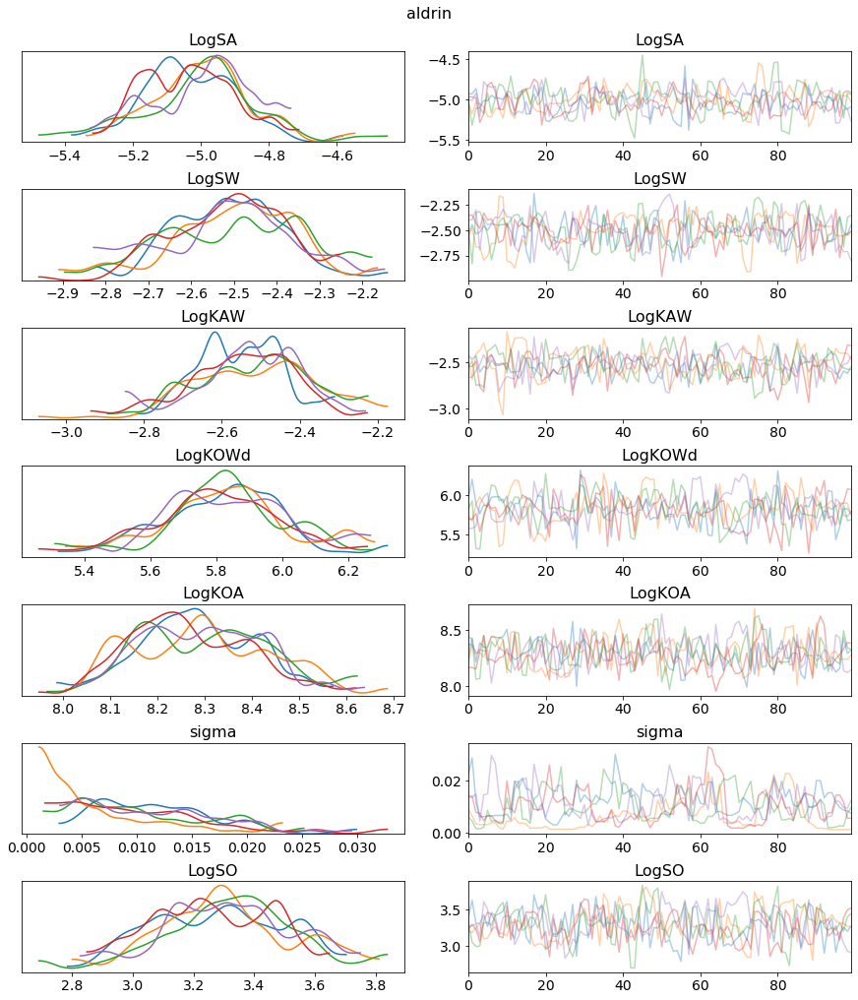

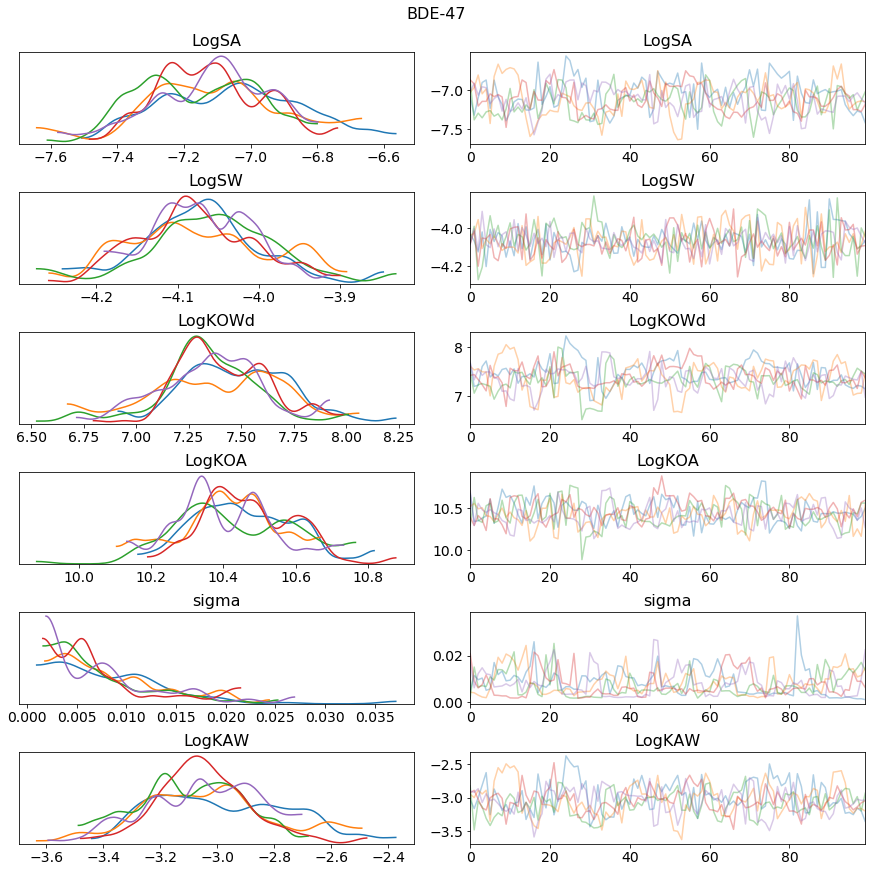

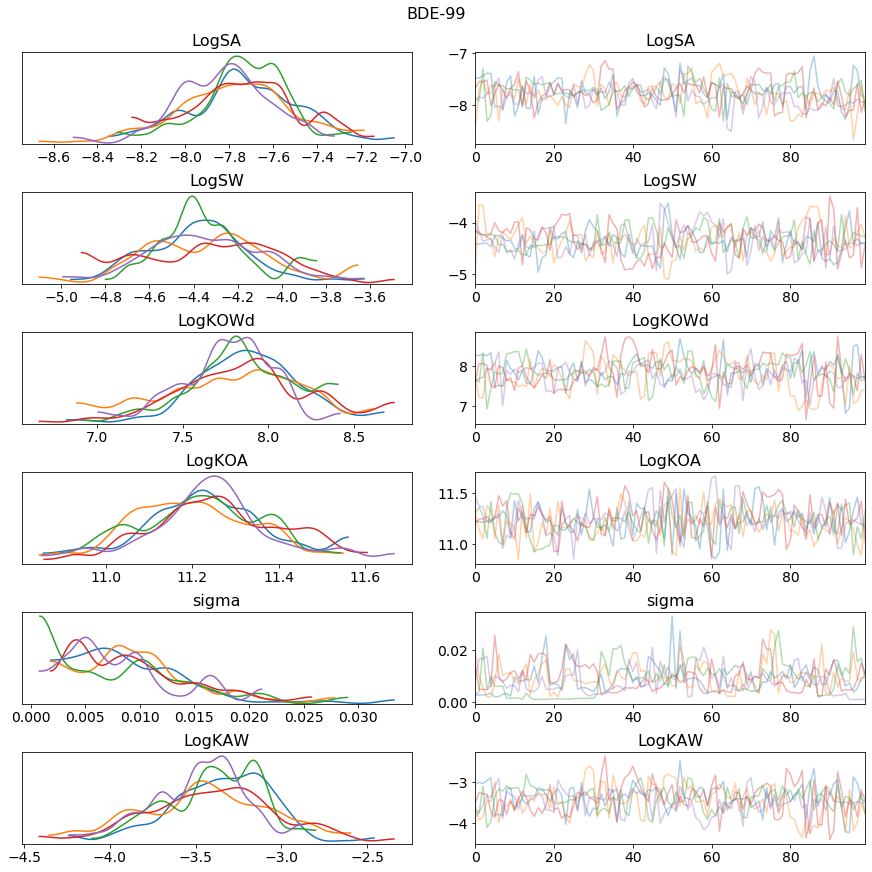

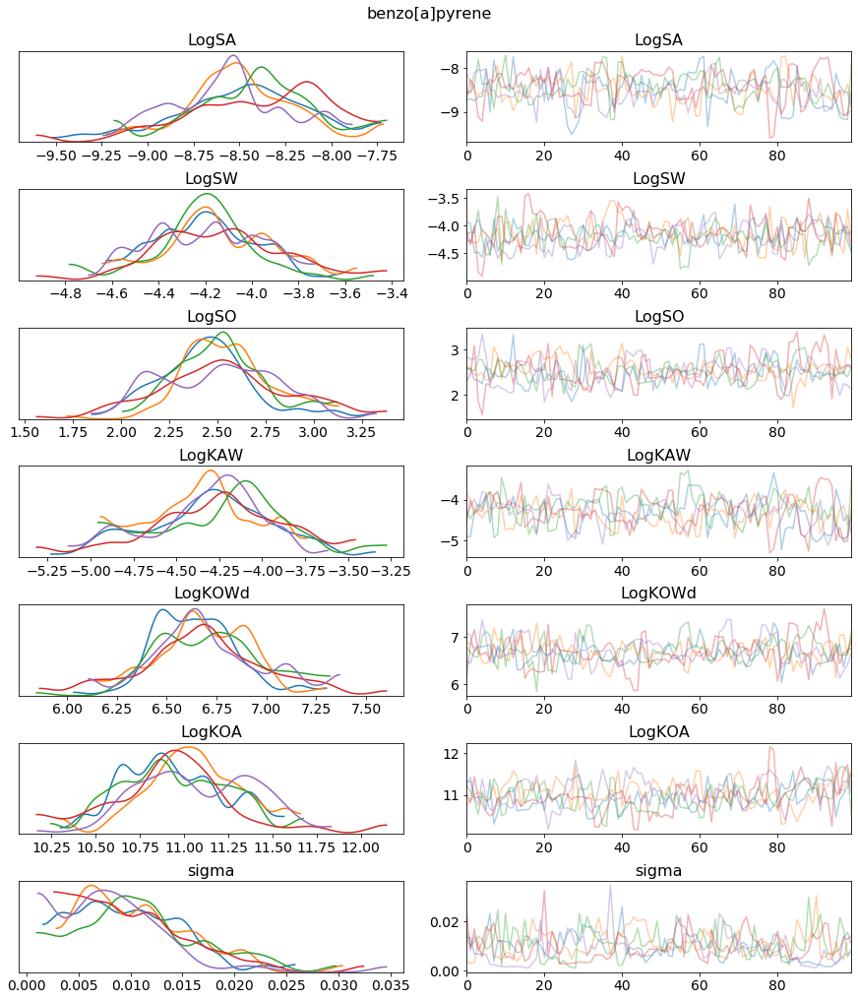

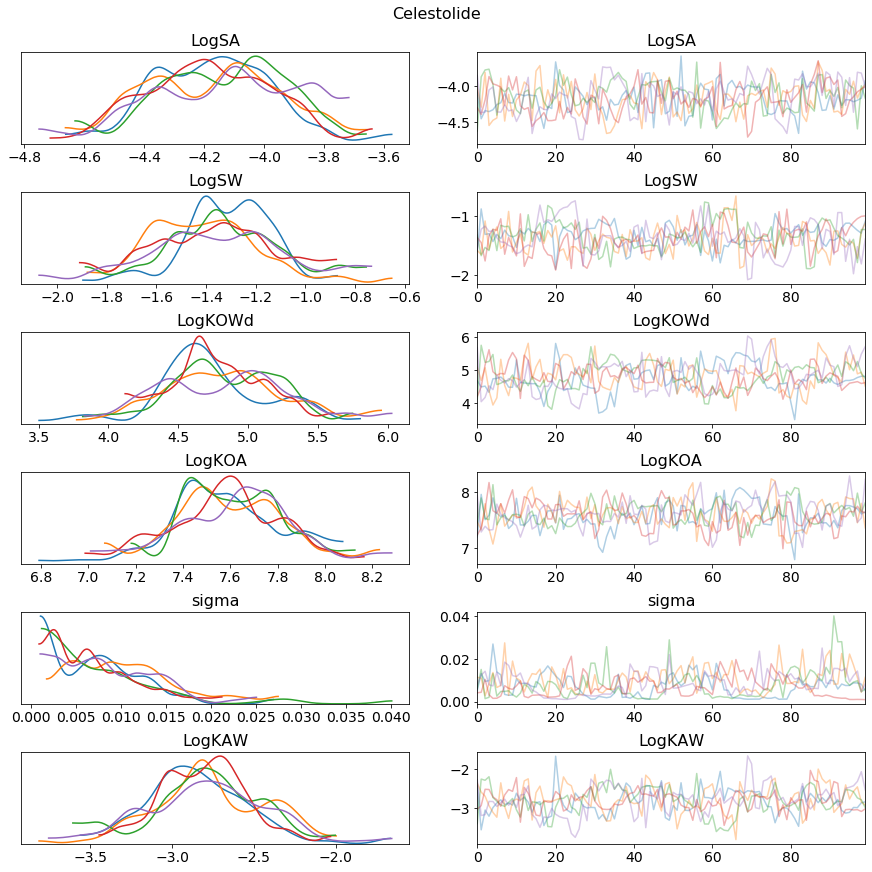

...

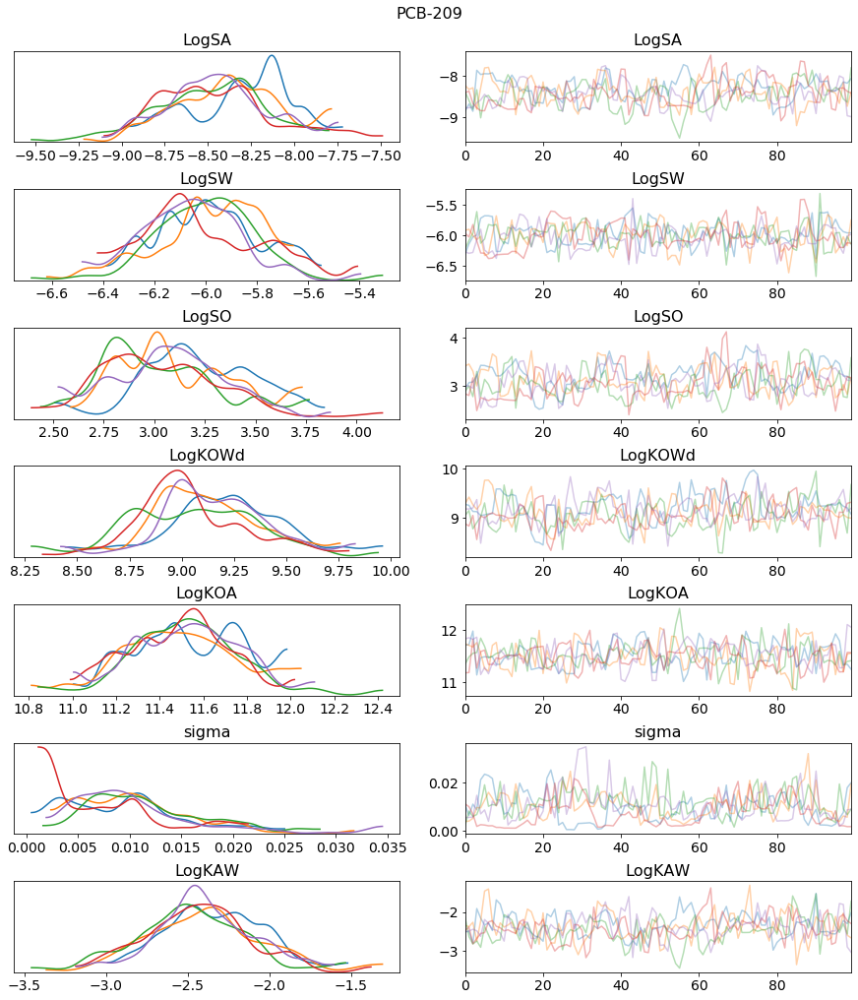

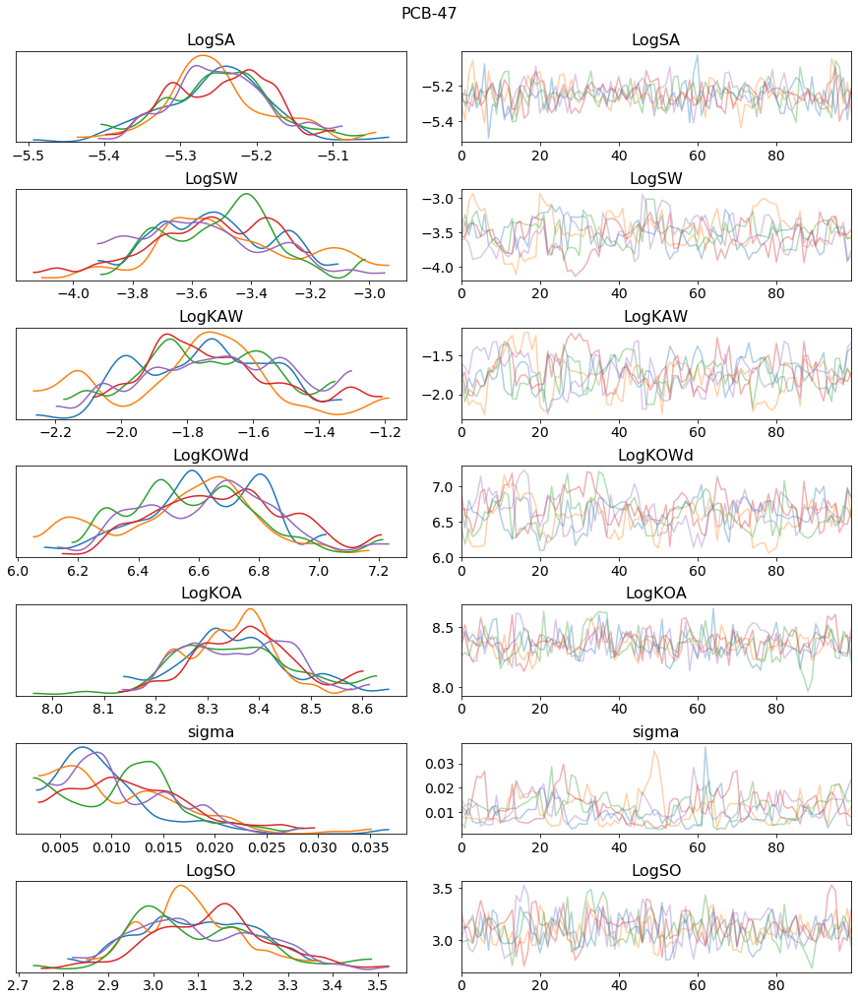

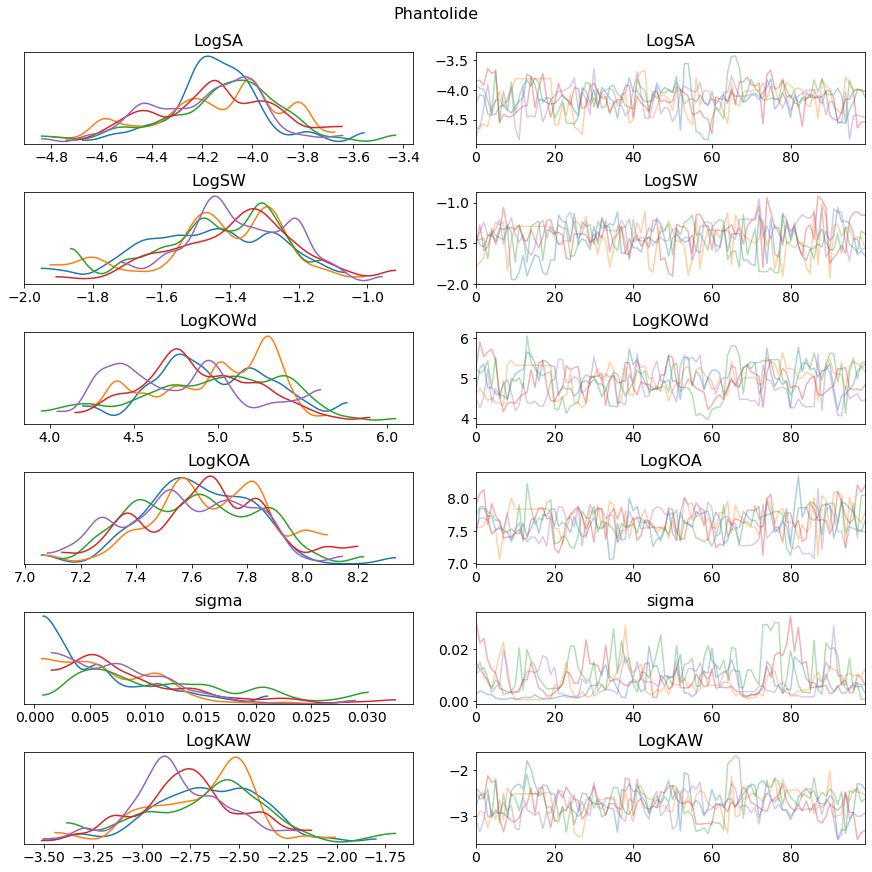

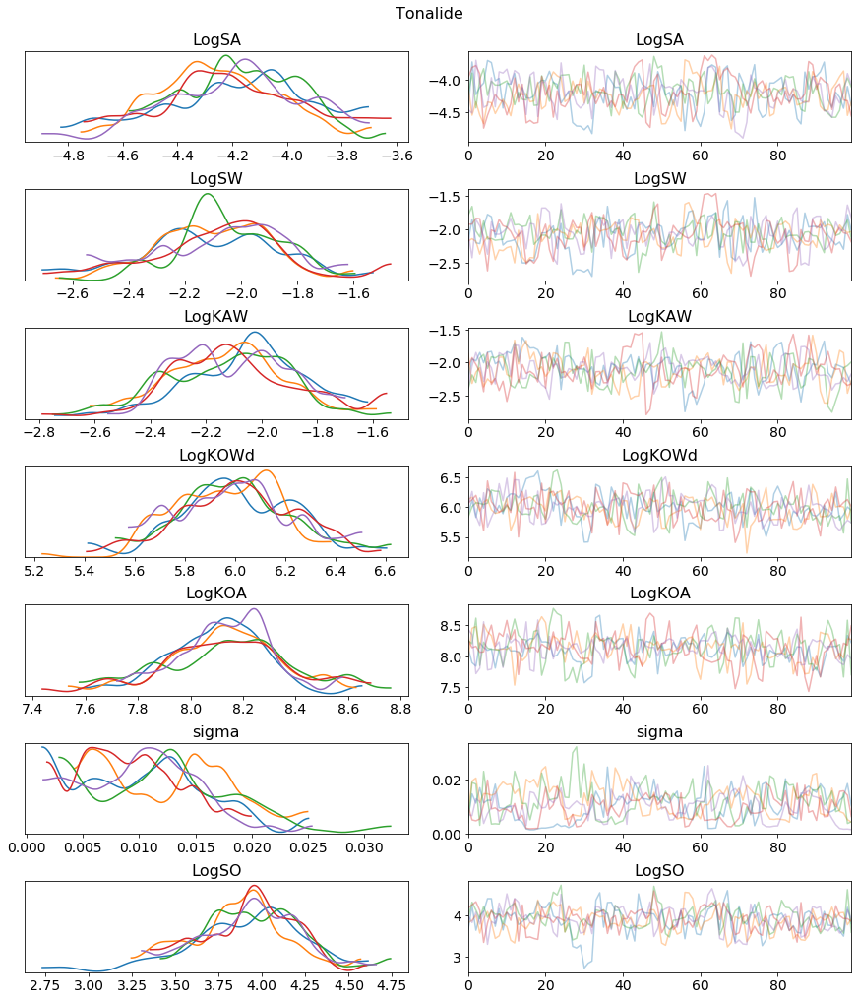

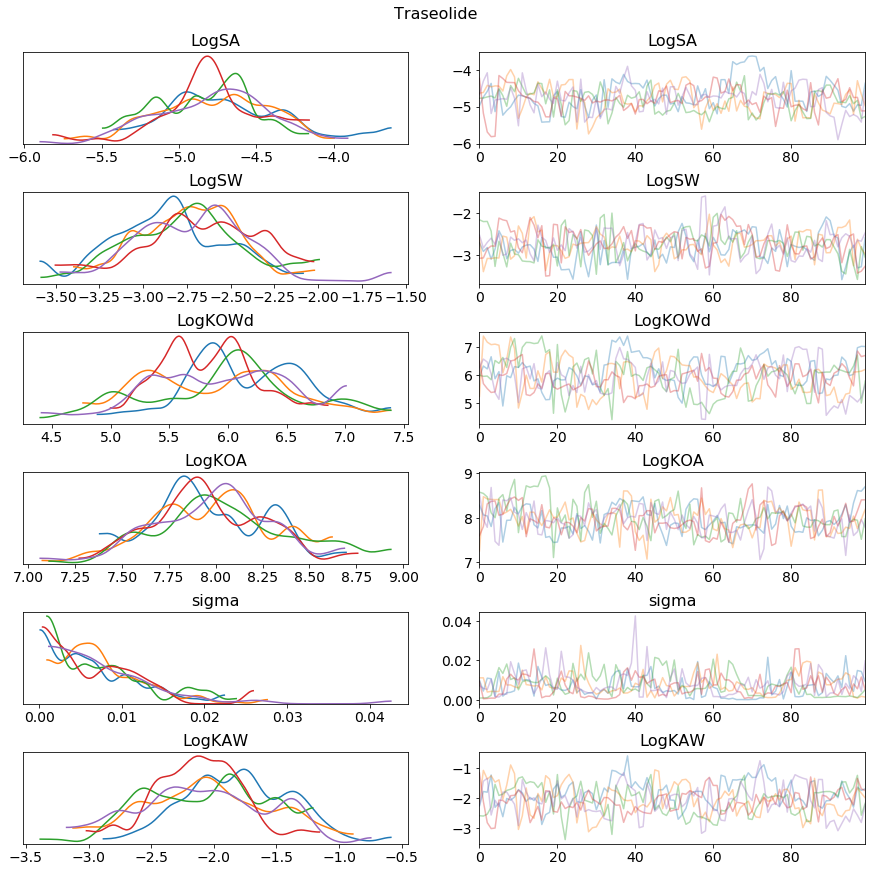

In [15]:
#Check the traceplots
directory = "Traces/KS/"
#Loop through all the files in the "Traces/KS" directory and display plots. You may want to change the directory to a
#sub-folder if you are running lots of compounds. This may take ~minutes for lots of plots
for filename in os.listdir(directory):
    #Define the compound from the filename
    #pdb.set_trace()
    comp = filename[0:filename.find("_")]
    if comp == "benzokfluoranthene": #Error from the square brackets in loading files
        comp = "benzo[k]fluoranthene"
    elif comp == "benzoapyrene":
        comp = "benzo[a]pyrene"
    try: 
        fig, tracesumm = fmf.plot_trace(comp,FAVs,filename=directory+filename,uDV=uLDV,model_type = 'KS')
        #Put it in the FAV dataframe at the same time, just in case the kernel was reloaded at some point.
        FAVs = fmf.trace_to_FAVs(comp,FAVs,filename = directory+filename,uDV=uLDV,model_type='KS')
        #Print the compound name and the traceplot summary tables
        comp
        tracesumm
    except KeyError:
        #Subfolders in the directory will return a keyerror.
        pass

In [35]:
#Restore the interactive shell.
InteractiveShell.ast_node_interactivity = 'last_expr'   

Unfortunately, that is all we can do with internal energies as we can't get a consistent system for any
of the other compounds. Soon, we will supplement this dataset with in silico estimations
and come back to make recommended FAVs (FAVRs) for all compounds. First, we will look at the adjustements and the misclosure errors of the FAVs to ensure that everything converged. Then we will export the KS FAVLs to a CSV file.

In [17]:
#Look at the adjustments
compounds = FAVs.loc[FAVs.loc[:,'LogSA']!=0,:].index
KSnames = ['LogSA','LogSW','LogSO','LogKAW','LogKOWd','LogKOA']
for prop in KSnames:
    FAVs.loc[compounds,'e_'+prop] = uLDV.loc[compounds,prop]-FAVs.loc[compounds,prop] 
#Display
FAVs.loc[compounds,'e_LogSA':'e_LogKOA']

,e_LogSA,e_LogSW,e_LogSO,e_LogKAW,e_LogKOWd,e_LogKOA
Compound Name,,,,,,
Musk Ambrette,0.18+/-0.27,-0.7+/-0.4,nan+/-0,nan+/-0.28711448738214473,-0.7+/-0.5,0.19+/-0.22
Celestolide,-0.01+/-0.25,0.01+/-0.29,nan+/-0,nan+/-0.33011338231808834,1.3+/-1.6,-0.02+/-0.31
Phantolide,-0.02+/-0.34,0.03+/-0.26,nan+/-0,nan+/-0.30142042006077185,1.1+/-1.6,-0.03+/-0.31
Traseolide,-0.1+/-0.5,-0.0+/-0.5,nan+/-0,nan+/-0.4805598446569748,0.1+/-2.4,-0.0+/-0.5
Moskene,0.9+/-0.9,-0.8+/-0.7,nan+/-0,nan+/-0.594213932646989,-0.8+/-0.7,0.2+/-0.5
Tonalide,-0.06+/-0.29,0.07+/-0.34,nan+/-0.2972248802039745,0.3+/-0.4,-0.1+/-0.4,0.11+/-0.31
Galaxolide 1,-0.10+/-0.19,0.04+/-0.11,nan+/-0.228941285938098,0.5+/-0.4,0.3+/-0.6,-0.06+/-0.28
Musk Tibetene,0.2+/-0.4,-1.1+/-0.7,nan+/-0,nan+/-0.5226454101140177,-1.0+/-0.6,0.22+/-0.34
"p,p'- DDE",0.02+/-0.26,0.2+/-0.4,-0.7+/-0.6,-0.1+/-0.6,0.9+/-0.7,-0.01+/-0.30


In [3]:
#Then we export the FAVs to a CSV file in the parent directory. Change the savename to include a folder if you want
#to save in a specific folder.
dUFAVLs_exp = fmf.export_FAVs(FAVs,savename = 'FAVLs_KS')

## Step 2: Estimate FAVRs for the partition coefficients & solubilities
Now (in a different application or by insterting cells here), pick your favourite in silico estimations and construct a set of KS values without any missing properties. On the Excel template enter the chosen in silico estimations into the "Table S9 Model Derived Values" worksheet, then save the output from the "LDV_MDV Output" sheet for importing (the default name "LDVMDV_Data.xlsx", to modify you can overwrite that sheet). 

In [18]:
#Load the data. I am going to use CDV here as "Combined Derived Values", consisting of LDVs and MDVs
CDV = pd.read_excel('LDVMDV_Data.xlsx', index_col = 2)
uCDV,FAVRs = fmf.loaddata(CDV)
#Display the header column of the uLDV.
uCDV.head()

,dVAPH,dUW,dUO,dUOA,dUAW,dUOW,LogKOA,LogKOW,LogKAW,LogPL,...,nKS_absent,w_dUAW,w_dUOW,w_dUOA,w_Ks,w4,w5,w_KAW,w_KOW,w_KOA
Compound Name,,,,,,,,,,,,,,,,,,,,,
cyclopentadecanone,65+/-12,1.5+/-1.3,NaN,35.5+/-2.2,69+/-12,1.2+/-2.3,6.59+/-0.17,5.7+/-1.1,-0.72+/-0.30,-0.3+/-0.4,...,0,-8+/-17,nan+/-2.662857317785656,nan+/-12.608899972750773,0.2+/-1.2,-0.3+/-1.3,-0.7+/-1.6,-0.6+/-0.6,-0.9+/-1.4,-1.2+/-0.9
15-pentadecanolide,77.0+/-2.5,5+/-4,NaN,-76+/-25,71+/-12,-0.6+/-1.2,8.6+/-1.1,5.8+/-0.6,-0.40+/-0.17,-1.08+/-0.06,...,0,-1+/-13,nan+/-4.163742018789697,nan+/-25.087834699710307,2.4+/-1.3,1.2+/-1.3,0.8+/-1.4,-1.2+/-0.4,-1.4+/-1.0,-0.2+/-1.4
Musk Ambrette,80+/-6,48+/-14,NaN,69.0+/-2.8,76+/-13,2.5+/-0.7,8.03+/-0.11,4.21+/-0.29,-4.7+/-2.0,-1.23+/-0.19,...,0,-47+/-20,nan+/-14.430796605938978,nan+/-6.308119700548489,-0.9+/-2.0,1.7+/-0.5,1.8+/-0.5,2.6+/-2.0,-1.0+/-0.6,0.7+/-0.5
16-hexadecanolide,73+/-10,8+/-7,NaN,52.3+/-3.3,74+/-13,-4+/-7,7.31+/-0.19,7.3+/-1.5,-0.33+/-0.14,-1.1+/-0.4,...,0,-11+/-17,nan+/-9.753425955430089,nan+/-10.308740421395354,-0.3+/-1.5,-1.2+/-1.6,-2.2+/-2.1,-0.9+/-0.6,-0.4+/-1.7,-1.6+/-0.9
Celestolide,79+/-20,-22+/-7,NaN,65+/-4,76+/-13,0.059+/-0.018,7.58+/-0.20,5.7+/-1.1,-2.0+/-0.8,-0.78+/-0.12,...,0,22+/-25,nan+/-6.569859457119444,nan+/-20.2934369649437,-0.1+/-1.4,-0.9+/-1.2,-1.4+/-1.6,-0.8+/-0.9,0.7+/-1.3,-0.2+/-0.7


In [22]:
#Check that compounds are not missing any properties
numKS_absent = 0
uCDV.loc[uCDV.nKS_absent>numKS_absent,'LogSA_absent':'LogKOA_absent']
#Empty - so they are all missing one or fewer properties

,LogSA_absent,LogSW_absent,LogSO_absent,LogKAW_absent,LogKOW_absent,LogKOA_absent
Compound Name,,,,,,


In [35]:
#Define the compounds that will be tried - here we loop through everything. For me looping through 
#all 74 compounds with 20k samples (10k tune + 10k trace) takes ~ a day
compounds = uCDV.index
#If you want to run a specific compound/list of compounds, comment out the above line and run the following:
#comps = ['Musk Ambrette']
for compound in compounds:
    #pdb.set_trace()
    #For some compounds we can't make an FAV. This will raise "ValueError", and we will skip that compound.
    try:
        FAVRs, enth_trace = fmf.run_model(compound,FAVRs,model_type ='KS',uDV = uCDV,savepath = 'Traces/FAVRs/KS/'
                                          trace = 10000, tune=10000,target_accept=0.9)
    except ValueError:
        pass

In [7]:
InteractiveShell.ast_node_interactivity = 'all'

'15-pentadecanolide'

,mean,sd,hpd_3%,hpd_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
LogSA,-4.415,0.193,-4.774,-4.046,0.001,0.001,21342.0,21342.0,21312.0,22305.0,1.0
LogSW,-2.953,0.342,-3.591,-2.303,0.003,0.002,15349.0,15349.0,15340.0,13889.0,1.0
LogSO,3.868,0.527,2.896,4.882,0.005,0.003,13420.0,13420.0,13411.0,17346.0,1.0
LogKAW,-1.448,0.379,-2.183,-0.750,0.003,0.002,15930.0,14845.0,15955.0,13193.0,1.0
LogKOWd,6.812,0.541,5.786,7.831,0.004,0.003,14861.0,14861.0,14828.0,19566.0,1.0
LogKOA,8.286,0.548,7.219,9.286,0.005,0.003,13756.0,13742.0,13729.0,18857.0,1.0
sigma,0.021,0.013,0.000,0.043,0.000,0.000,5978.0,5978.0,1825.0,624.0,1.0


'16-hexadecanolide'

,mean,sd,hpd_3%,hpd_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
LogSA,-4.241,0.389,-4.987,-3.531,0.002,0.002,32213.0,32213.0,32207.0,34481.0,1.0
LogSW,-3.518,0.481,-4.404,-2.589,0.003,0.002,32180.0,32180.0,32165.0,35593.0,1.0
LogSO,3.432,0.562,2.375,4.492,0.003,0.002,25996.0,25910.0,25995.0,32891.0,1.0
LogKAW,-0.721,0.565,-1.791,0.324,0.003,0.002,26810.0,26810.0,26811.0,34377.0,1.0
LogKOWd,6.954,0.690,5.642,8.227,0.004,0.003,23961.0,23952.0,23963.0,31099.0,1.0
LogKOA,7.663,0.483,6.769,8.588,0.003,0.002,32089.0,32032.0,32094.0,37473.0,1.0
sigma,0.021,0.013,0.000,0.043,0.000,0.000,25351.0,25351.0,16476.0,11412.0,1.0


'2-ethylhexyl salicylate'

,mean,sd,hpd_3%,hpd_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
LogSA,-4.725,0.212,-5.125,-4.327,0.001,0.001,22286.0,22286.0,22326.0,24954.0,1.0
LogSW,-2.540,0.286,-3.068,-1.989,0.004,0.003,5519.0,4458.0,5823.0,1752.0,1.0
LogSO,3.663,0.483,2.783,4.600,0.004,0.003,16950.0,16950.0,16944.0,23168.0,1.0
LogKAW,-2.196,0.321,-2.784,-1.578,0.003,0.002,9218.0,9218.0,9174.0,1673.0,1.0
LogKOWd,6.205,0.552,5.170,7.243,0.005,0.004,11415.0,10690.0,11514.0,3047.0,1.0
LogKOA,8.386,0.486,7.480,9.306,0.004,0.003,17190.0,17190.0,17193.0,22471.0,1.0
sigma,0.021,0.013,0.001,0.043,0.000,0.000,8571.0,8571.0,3096.0,1223.0,1.0


'3-(4-methylbenzilidine) camphor'

,mean,sd,hpd_3%,hpd_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
LogSA,-5.344,0.363,-6.029,-4.659,0.003,0.002,14789.0,14714.0,14777.0,18739.0,1.0
LogSW,-1.964,0.230,-2.396,-1.533,0.002,0.001,22741.0,22488.0,22738.0,24786.0,1.0
LogSO,3.200,0.378,2.502,3.916,0.003,0.002,16058.0,16058.0,16073.0,20469.0,1.0
LogKAW,-3.375,0.393,-4.129,-2.657,0.003,0.002,14765.0,14546.0,14772.0,19386.0,1.0
LogKOWd,5.165,0.417,4.386,5.947,0.003,0.002,15485.0,15485.0,15480.0,22001.0,1.0
LogKOA,8.542,0.211,8.143,8.939,0.001,0.001,24452.0,24452.0,24459.0,23562.0,1.0
sigma,0.021,0.013,0.001,0.044,0.000,0.000,13111.0,13111.0,6293.0,3220.0,1.0


'aldrin'

,mean,sd,hpd_3%,hpd_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
LogSA,-4.960,0.172,-5.277,-4.633,0.001,0.001,17278.0,17243.0,17248.0,24168.0,1.0
LogSW,-2.513,0.183,-2.859,-2.168,0.001,0.001,20759.0,20638.0,20761.0,23764.0,1.0
LogSO,3.373,0.233,2.932,3.809,0.002,0.001,15142.0,15142.0,15126.0,10529.0,1.0
LogKAW,-2.498,0.180,-2.838,-2.162,0.001,0.001,15873.0,15121.0,15955.0,14400.0,1.0
LogKOWd,5.921,0.256,5.423,6.391,0.002,0.001,14906.0,14906.0,14774.0,3588.0,1.0
LogKOA,8.301,0.144,8.026,8.569,0.001,0.001,22488.0,22432.0,22508.0,25026.0,1.0
sigma,0.022,0.013,0.001,0.045,0.000,0.000,13507.0,13507.0,5987.0,2298.0,1.0


'anti-DDC-CO'

,mean,sd,hpd_3%,hpd_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
LogSA,-12.048,1.387,-14.647,-9.427,0.011,0.008,16674.0,16326.0,16736.0,16686.0,1.0
LogSW,-7.384,2.038,-11.229,-3.596,0.018,0.013,12720.0,12586.0,12723.0,16024.0,1.0
LogSO,1.634,2.049,-2.296,5.398,0.017,0.012,14913.0,13523.0,14912.0,16905.0,1.0
LogKAW,-4.663,2.034,-8.438,-0.741,0.018,0.012,13500.0,13289.0,13498.0,16982.0,1.0
LogKOWd,9.016,2.225,4.726,13.076,0.019,0.014,13076.0,12780.0,13077.0,16322.0,1.0
LogKOA,13.682,2.045,9.729,17.452,0.016,0.012,15370.0,15370.0,15328.0,18868.0,1.0
sigma,0.021,0.013,0.001,0.043,0.000,0.000,6335.0,6335.0,2375.0,735.0,1.0


'Avobenzone'

,mean,sd,hpd_3%,hpd_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
LogSA,-8.924,0.919,-10.626,-7.178,0.007,0.005,15130.0,14849.0,15182.0,12525.0,1.0
LogSW,-3.407,0.934,-5.187,-1.704,0.008,0.006,13216.0,13204.0,13283.0,18836.0,1.0
LogSO,2.034,0.922,0.305,3.777,0.007,0.005,17600.0,17574.0,17602.0,19806.0,1.0
LogKAW,-5.520,1.177,-7.697,-3.285,0.010,0.007,13879.0,13879.0,13894.0,15530.0,1.0
LogKOWd,5.440,1.189,3.189,7.659,0.010,0.007,14163.0,14133.0,14159.0,18632.0,1.0
LogKOA,10.959,1.167,8.723,13.106,0.009,0.006,16122.0,16122.0,16116.0,18666.0,1.0
sigma,0.021,0.013,0.001,0.043,0.000,0.000,9871.0,9871.0,4536.0,1705.0,1.0


'BDE-100'

,mean,sd,hpd_3%,hpd_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
LogSA,-7.817,0.140,-8.085,-7.558,0.001,0.001,18885.0,18857.0,18916.0,16170.0,1.0
LogSW,-3.981,0.200,-4.356,-3.607,0.002,0.001,16316.0,16316.0,16339.0,24254.0,1.0
LogSO,3.555,0.297,2.989,4.103,0.002,0.002,15075.0,14862.0,15080.0,20092.0,1.0
LogKAW,-3.835,0.248,-4.299,-3.370,0.002,0.001,16294.0,16262.0,16276.0,16854.0,1.0
LogKOWd,7.547,0.319,6.957,8.153,0.003,0.002,15251.0,15219.0,15249.0,21814.0,1.0
LogKOA,11.372,0.284,10.839,11.912,0.002,0.002,15043.0,15001.0,15050.0,18450.0,1.0
sigma,0.021,0.013,0.001,0.043,0.000,0.000,10474.0,10474.0,5084.0,2010.0,1.0


'BDE-47'

,mean,sd,hpd_3%,hpd_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
LogSA,-7.208,0.166,-7.514,-6.888,0.001,0.001,17470.0,17468.0,17467.0,23634.0,1.0
LogSW,-4.067,0.070,-4.199,-3.937,0.000,0.000,26220.0,26220.0,26268.0,26571.0,1.0
LogSO,3.182,0.206,2.800,3.569,0.002,0.001,16792.0,16792.0,16791.0,21320.0,1.0
LogKAW,-3.150,0.191,-3.508,-2.791,0.001,0.001,17776.0,17677.0,17759.0,23718.0,1.0
LogKOWd,7.252,0.226,6.823,7.668,0.002,0.001,17036.0,17036.0,17048.0,23145.0,1.0
LogKOA,10.405,0.128,10.156,10.638,0.001,0.001,25332.0,25326.0,25327.0,27254.0,1.0
sigma,0.021,0.013,0.001,0.043,0.000,0.000,14605.0,14605.0,5896.0,2586.0,1.0


'BDE-66'

,mean,sd,hpd_3%,hpd_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
LogSA,-7.201,0.226,-7.616,-6.768,0.002,0.001,14739.0,14739.0,14744.0,20564.0,1.0
LogSW,-3.841,0.583,-4.945,-2.741,0.005,0.004,11839.0,10981.0,11850.0,8746.0,1.0
LogSO,3.452,0.403,2.676,4.201,0.005,0.004,5507.0,4581.0,5711.0,1622.0,1.0
LogKAW,-3.361,0.607,-4.521,-2.228,0.006,0.004,10305.0,10305.0,10390.0,7251.0,1.0
LogKOWd,7.297,0.661,6.046,8.528,0.007,0.005,8188.0,7750.0,8202.0,6970.0,1.0
LogKOA,10.654,0.339,10.042,11.320,0.004,0.003,8653.0,8229.0,8923.0,3011.0,1.0
sigma,0.021,0.013,0.001,0.043,0.000,0.000,7061.0,7061.0,2574.0,959.0,1.0


'BDE-71'

,mean,sd,hpd_3%,hpd_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
LogSA,-7.172,0.727,-8.545,-5.812,0.005,0.004,19104.0,19104.0,19057.0,20441.0,1.0
LogSW,-3.936,1.085,-6.039,-1.946,0.010,0.008,10927.0,9561.0,10973.0,7859.0,1.0
LogSO,3.245,0.903,1.552,4.952,0.008,0.006,11499.0,11499.0,11544.0,9105.0,1.0
LogKAW,-3.238,1.047,-5.231,-1.334,0.010,0.007,11119.0,11119.0,11127.0,16901.0,1.0
LogKOWd,7.185,1.092,5.150,9.223,0.010,0.007,11732.0,10946.0,11806.0,10411.0,1.0
LogKOA,10.417,0.735,9.023,11.815,0.007,0.005,12553.0,12553.0,12619.0,10173.0,1.0
sigma,0.021,0.013,0.001,0.043,0.000,0.000,9103.0,9103.0,4450.0,1494.0,1.0


'BDE-99'

,mean,sd,hpd_3%,hpd_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
LogSA,-7.871,0.243,-8.321,-7.412,0.002,0.001,16564.0,16564.0,16576.0,23645.0,1.0
LogSW,-4.343,0.258,-4.811,-3.843,0.002,0.001,16354.0,16354.0,16413.0,9004.0,1.0
LogSO,3.343,0.276,2.833,3.864,0.002,0.002,14594.0,14426.0,14560.0,15572.0,1.0
LogKAW,-3.532,0.314,-4.100,-2.917,0.002,0.002,18411.0,18411.0,18412.0,21971.0,1.0
LogKOWd,7.700,0.317,7.117,8.305,0.002,0.002,16937.0,16874.0,16941.0,20780.0,1.0
LogKOA,11.211,0.159,10.920,11.514,0.001,0.001,12679.0,12404.0,13099.0,7791.0,1.0
sigma,0.021,0.013,0.001,0.043,0.000,0.000,10366.0,10366.0,4753.0,1950.0,1.0


'benzo[a]pyrene'

,mean,sd,hpd_3%,hpd_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
LogSA,-8.481,0.374,-9.156,-7.755,0.003,0.002,19076.0,19048.0,19093.0,23744.0,1.0
LogSW,-4.182,0.244,-4.645,-3.731,0.002,0.001,17266.0,17093.0,17270.0,24411.0,1.0
LogSO,2.491,0.293,1.938,3.040,0.002,0.001,20861.0,20861.0,20889.0,19030.0,1.0
LogKAW,-4.302,0.397,-5.056,-3.566,0.003,0.002,17920.0,17879.0,17931.0,23729.0,1.0
LogKOWd,6.674,0.285,6.141,7.203,0.002,0.002,16880.0,16503.0,16835.0,10184.0,1.0
LogKOA,10.982,0.363,10.298,11.666,0.003,0.002,19393.0,19366.0,19401.0,23610.0,1.0
sigma,0.021,0.013,0.001,0.043,0.000,0.000,10221.0,10221.0,4494.0,1746.0,1.0


'benzo[k]fluoranthene'

,mean,sd,hpd_3%,hpd_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
LogSA,-8.236,0.305,-8.803,-7.660,0.003,0.002,8239.0,8208.0,8255.0,4818.0,1.0
LogSW,-3.520,0.239,-3.970,-3.076,0.003,0.002,6618.0,6618.0,6730.0,4040.0,1.0
LogSO,2.587,0.344,1.968,3.257,0.003,0.002,10970.0,9860.0,10917.0,3696.0,1.0
LogKAW,-4.715,0.363,-5.386,-4.036,0.004,0.003,9780.0,9780.0,9821.0,18541.0,1.0
LogKOWd,6.106,0.347,5.456,6.762,0.003,0.002,11911.0,11539.0,11857.0,7632.0,1.0
LogKOA,10.836,0.336,10.210,11.466,0.003,0.002,13308.0,13237.0,13365.0,23521.0,1.0
sigma,0.021,0.013,0.001,0.043,0.000,0.000,4724.0,4724.0,2040.0,674.0,1.0


'benzophenone-D10'

,mean,sd,hpd_3%,hpd_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
LogSA,-4.354,0.264,-4.851,-3.859,0.001,0.001,50124.0,50085.0,50133.0,52122.0,1.0
LogSW,0.096,0.424,-0.703,0.892,0.002,0.002,42145.0,34972.0,42158.0,44317.0,1.0
LogSO,3.003,0.324,2.392,3.614,0.002,0.001,44882.0,44797.0,44875.0,50023.0,1.0
LogKAW,-4.452,0.435,-5.262,-3.626,0.002,0.002,40909.0,40909.0,40922.0,46754.0,1.0
LogKOWd,2.911,0.426,2.119,3.723,0.002,0.001,42513.0,42444.0,42541.0,46931.0,1.0
LogKOA,7.367,0.264,6.869,7.860,0.001,0.001,50001.0,49918.0,50006.0,51630.0,1.0
sigma,0.021,0.013,0.000,0.043,0.000,0.000,36404.0,36404.0,21637.0,12210.0,1.0


'Celestolide'

,mean,sd,hpd_3%,hpd_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
LogSA,-4.009,0.312,-4.579,-3.404,0.002,0.002,19685.0,19685.0,19677.0,22138.0,1.0
LogSW,-1.502,0.337,-2.150,-0.876,0.002,0.002,18218.0,17960.0,18246.0,19959.0,1.0
LogSO,3.634,0.407,2.881,4.416,0.003,0.002,16826.0,16721.0,16814.0,22799.0,1.0
LogKAW,-2.500,0.424,-3.292,-1.702,0.003,0.002,16260.0,16260.0,16275.0,21335.0,1.0
LogKOWd,5.140,0.498,4.218,6.092,0.004,0.003,14829.0,14752.0,14829.0,20891.0,1.0
LogKOA,7.639,0.329,7.024,8.260,0.002,0.002,20795.0,20775.0,20795.0,19262.0,1.0
sigma,0.021,0.013,0.001,0.043,0.000,0.000,11231.0,11231.0,4733.0,1808.0,1.0


'Cervolide'

,mean,sd,hpd_3%,hpd_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
LogSA,-4.344,0.264,-4.845,-3.852,0.002,0.001,18020.0,17770.0,18077.0,10684.0,1.0
LogSW,-1.314,0.487,-2.206,-0.374,0.004,0.003,14033.0,14033.0,14005.0,19888.0,1.0
LogSO,3.477,0.524,2.470,4.443,0.004,0.003,14555.0,14509.0,14553.0,19053.0,1.0
LogKAW,-3.021,0.525,-4.030,-2.059,0.004,0.003,15019.0,14851.0,15024.0,19859.0,1.0
LogKOWd,4.789,0.671,3.504,6.017,0.006,0.004,12773.0,12773.0,12780.0,18466.0,1.0
LogKOA,7.819,0.486,6.907,8.728,0.004,0.003,13522.0,13387.0,13571.0,21097.0,1.0
sigma,0.021,0.013,0.001,0.043,0.000,0.000,5464.0,5464.0,1730.0,599.0,1.0


'cyclopentadecanone'

,mean,sd,hpd_3%,hpd_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
LogSA,-3.380,0.360,-4.048,-2.688,0.003,0.002,19950.0,19950.0,19956.0,25008.0,1.0
LogSW,-2.450,0.363,-3.134,-1.777,0.002,0.002,22266.0,22257.0,22269.0,24578.0,1.0
LogSO,3.417,0.453,2.563,4.268,0.004,0.003,15774.0,15763.0,15770.0,20996.0,1.0
LogKAW,-0.927,0.455,-1.780,-0.068,0.003,0.002,17656.0,17654.0,17656.0,21226.0,1.0
LogKOWd,5.868,0.536,4.825,6.841,0.004,0.003,15302.0,15302.0,15310.0,19946.0,1.0
LogKOA,6.786,0.363,6.094,7.466,0.003,0.002,18968.0,18968.0,18979.0,21926.0,1.0
sigma,0.021,0.013,0.001,0.043,0.000,0.000,17392.0,17392.0,11991.0,6802.0,1.0


'DPTE'

,mean,sd,hpd_3%,hpd_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
LogSA,-7.016,0.297,-7.564,-6.447,0.002,0.002,18371.0,18332.0,18315.0,21927.0,1.0
LogSW,-3.350,0.677,-4.643,-2.095,0.006,0.004,13814.0,13770.0,13822.0,19205.0,1.0
LogSO,1.925,0.343,1.278,2.565,0.003,0.002,12975.0,12336.0,13003.0,20373.0,1.0
LogKAW,-3.671,0.701,-5.001,-2.359,0.006,0.004,13045.0,12752.0,13070.0,19321.0,1.0
LogKOWd,5.280,0.714,3.965,6.646,0.006,0.004,13592.0,13592.0,13637.0,18840.0,1.0
LogKOA,8.923,0.250,8.455,9.391,0.002,0.001,17182.0,17109.0,17158.0,23295.0,1.0
sigma,0.021,0.013,0.001,0.043,0.000,0.000,9552.0,9552.0,4656.0,1820.0,1.0


'EHDPP'

,mean,sd,hpd_3%,hpd_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
LogSA,-7.677,0.204,-8.072,-7.306,0.001,0.001,23619.0,23560.0,23614.0,22171.0,1.0
LogSW,-2.804,0.539,-3.803,-1.771,0.004,0.003,14384.0,14384.0,14393.0,20241.0,1.0
LogSO,2.990,0.335,2.368,3.627,0.002,0.002,19043.0,19004.0,19044.0,22185.0,1.0
LogKAW,-4.875,0.555,-5.930,-3.842,0.005,0.003,14186.0,14145.0,14185.0,19334.0,1.0
LogKOWd,5.795,0.510,4.841,6.749,0.004,0.003,15329.0,15327.0,15326.0,21057.0,1.0
LogKOA,10.675,0.334,10.039,11.292,0.002,0.002,18983.0,18964.0,18989.0,23269.0,1.0
sigma,0.021,0.013,0.001,0.043,0.000,0.000,12230.0,12230.0,6587.0,3068.0,1.0


D:\Anaconda3\lib\site-packages\arviz\plots\traceplot.py:185: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  len(plotters), 2, squeeze=False, figsize=figsize, constrained_layout=True


'Galaxolide 1'

,mean,sd,hpd_3%,hpd_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
LogSA,-4.552,0.129,-4.791,-4.307,0.001,0.001,15261.0,15188.0,15287.0,11831.0,1.0
LogSW,-2.167,0.076,-2.309,-2.026,0.000,0.000,23244.0,23233.0,23245.0,23443.0,1.0
LogSO,3.536,0.232,3.096,3.968,0.002,0.001,16449.0,16449.0,16424.0,21990.0,1.0
LogKAW,-2.350,0.165,-2.659,-2.041,0.001,0.001,18435.0,18320.0,18421.0,19340.0,1.0
LogKOWd,5.711,0.250,5.237,6.179,0.002,0.001,17515.0,17494.0,17503.0,23271.0,1.0
LogKOA,8.072,0.195,7.710,8.445,0.001,0.001,19039.0,19039.0,19025.0,18793.0,1.0
sigma,0.021,0.013,0.001,0.043,0.000,0.000,13689.0,13689.0,5455.0,2280.0,1.0


D:\Anaconda3\lib\site-packages\arviz\plots\traceplot.py:185: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  len(plotters), 2, squeeze=False, figsize=figsize, constrained_layout=True


'Homosolate'

,mean,sd,hpd_3%,hpd_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
LogSA,-5.281,0.102,-5.477,-5.094,0.000,0.000,42314.0,42261.0,42328.0,39809.0,1.0
LogSW,-2.759,0.296,-3.309,-2.197,0.002,0.001,29323.0,28943.0,29360.0,34759.0,1.0
LogSO,3.279,0.240,2.829,3.727,0.001,0.001,32019.0,32019.0,32017.0,37833.0,1.0
LogKAW,-2.530,0.311,-3.128,-1.954,0.002,0.001,29390.0,29390.0,29404.0,35530.0,1.0
LogKOWd,6.042,0.383,5.327,6.765,0.002,0.002,27405.0,27405.0,27395.0,34845.0,1.0
LogKOA,8.549,0.206,8.162,8.936,0.001,0.001,34919.0,34919.0,34902.0,36355.0,1.0
sigma,0.021,0.013,0.001,0.044,0.000,0.000,28094.0,28094.0,18497.0,12127.0,1.0


D:\Anaconda3\lib\site-packages\arviz\plots\traceplot.py:185: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  len(plotters), 2, squeeze=False, figsize=figsize, constrained_layout=True


'Moskene'

,mean,sd,hpd_3%,hpd_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
LogSA,-5.465,0.564,-6.534,-4.412,0.004,0.003,19421.0,19377.0,19422.0,23800.0,1.0
LogSW,-2.765,0.639,-3.967,-1.574,0.005,0.004,15155.0,15015.0,15178.0,19222.0,1.0
LogSO,2.429,0.612,1.259,3.570,0.005,0.003,17162.0,17092.0,17158.0,21622.0,1.0
LogKAW,-2.703,0.654,-3.930,-1.471,0.005,0.004,15259.0,15259.0,15268.0,19208.0,1.0
LogKOWd,5.183,0.624,3.996,6.339,0.005,0.003,17174.0,17041.0,17168.0,20645.0,1.0
LogKOA,7.903,0.387,7.180,8.631,0.003,0.002,15608.0,15467.0,15544.0,21633.0,1.0
sigma,0.021,0.013,0.001,0.043,0.000,0.000,8255.0,8255.0,2656.0,988.0,1.0


D:\Anaconda3\lib\site-packages\arviz\plots\traceplot.py:185: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  len(plotters), 2, squeeze=False, figsize=figsize, constrained_layout=True


'Musk Ambrette'

,mean,sd,hpd_3%,hpd_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
LogSA,-4.843,0.399,-5.595,-4.093,0.002,0.002,31075.0,31075.0,31021.0,28889.0,1.0
LogSW,-1.637,0.634,-2.822,-0.434,0.004,0.003,25095.0,25095.0,25105.0,32368.0,1.0
LogSO,3.025,0.523,2.035,3.999,0.003,0.002,26771.0,26557.0,26770.0,31713.0,1.0
LogKAW,-3.209,0.650,-4.441,-1.997,0.004,0.003,27168.0,27020.0,27171.0,33194.0,1.0
LogKOWd,4.655,0.637,3.464,5.865,0.004,0.003,27840.0,27840.0,27835.0,32686.0,1.0
LogKOA,7.875,0.399,7.130,8.631,0.002,0.002,30431.0,30417.0,30411.0,34636.0,1.0
sigma,0.021,0.013,0.000,0.043,0.000,0.000,16630.0,16630.0,5858.0,2470.0,1.0


D:\Anaconda3\lib\site-packages\arviz\plots\traceplot.py:185: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  len(plotters), 2, squeeze=False, figsize=figsize, constrained_layout=True


'Musk Tibetene'

,mean,sd,hpd_3%,hpd_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
LogSA,-5.568,0.412,-6.346,-4.793,0.003,0.002,20393.0,20393.0,20401.0,23332.0,1.0
LogSW,-2.608,0.656,-3.851,-1.384,0.005,0.004,16888.0,16888.0,16890.0,19349.0,1.0
LogSO,2.595,0.546,1.555,3.611,0.004,0.003,16849.0,16510.0,16852.0,16970.0,1.0
LogKAW,-2.960,0.666,-4.256,-1.740,0.005,0.004,17425.0,16964.0,17437.0,20585.0,1.0
LogKOWd,5.192,0.658,3.952,6.418,0.005,0.004,17455.0,17455.0,17491.0,19521.0,1.0
LogKOA,8.173,0.416,7.396,8.967,0.003,0.002,18014.0,17993.0,18022.0,21307.0,1.0
sigma,0.021,0.013,0.001,0.044,0.000,0.000,13991.0,13991.0,8081.0,3496.0,1.0


D:\Anaconda3\lib\site-packages\arviz\plots\traceplot.py:185: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  len(plotters), 2, squeeze=False, figsize=figsize, constrained_layout=True


'Muskonate'

,mean,sd,hpd_3%,hpd_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
LogSA,-4.664,0.265,-5.157,-4.169,0.002,0.001,22865.0,22865.0,22883.0,23738.0,1.0
LogSW,-0.598,0.365,-1.280,0.095,0.003,0.002,19411.0,19411.0,19413.0,23332.0,1.0
LogSO,3.197,0.394,2.441,3.922,0.003,0.002,18207.0,18114.0,18220.0,23280.0,1.0
LogKAW,-4.059,0.425,-4.847,-3.258,0.003,0.002,17851.0,17758.0,17862.0,21282.0,1.0
LogKOWd,3.791,0.463,2.932,4.667,0.003,0.002,17612.0,17612.0,17618.0,21754.0,1.0
LogKOA,7.859,0.355,7.193,8.532,0.003,0.002,18539.0,18539.0,18550.0,17917.0,1.0
sigma,0.021,0.013,0.001,0.043,0.000,0.000,14774.0,14774.0,8562.0,3986.0,1.0


D:\Anaconda3\lib\site-packages\arviz\plots\traceplot.py:185: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  len(plotters), 2, squeeze=False, figsize=figsize, constrained_layout=True


"o,p'-DDD"

,mean,sd,hpd_3%,hpd_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
LogSA,-5.978,0.171,-6.305,-5.660,0.001,0.001,22608.0,22608.0,22587.0,25908.0,1.0
LogSW,-2.743,0.321,-3.360,-2.156,0.003,0.002,14676.0,14214.0,14687.0,18340.0,1.0
LogSO,3.373,0.275,2.858,3.892,0.002,0.001,18063.0,17878.0,18062.0,22383.0,1.0
LogKAW,-3.234,0.349,-3.908,-2.603,0.003,0.002,16348.0,16348.0,16371.0,20241.0,1.0
LogKOWd,6.109,0.407,5.323,6.853,0.003,0.002,15052.0,14627.0,15086.0,19825.0,1.0
LogKOA,9.359,0.217,8.960,9.774,0.002,0.001,19352.0,19287.0,19374.0,20555.0,1.0
sigma,0.021,0.013,0.001,0.043,0.000,0.000,7624.0,7624.0,3017.0,1117.0,1.0


D:\Anaconda3\lib\site-packages\arviz\plots\traceplot.py:185: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  len(plotters), 2, squeeze=False, figsize=figsize, constrained_layout=True


"o,p'-DDT"

,mean,sd,hpd_3%,hpd_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
LogSA,-6.283,0.175,-6.605,-5.949,0.001,0.001,20326.0,20326.0,20341.0,23718.0,1.0
LogSW,-2.820,0.251,-3.294,-2.345,0.002,0.002,13192.0,12482.0,13294.0,5076.0,1.0
LogSO,3.199,0.229,2.768,3.627,0.002,0.001,19475.0,19459.0,19475.0,23611.0,1.0
LogKAW,-3.451,0.248,-3.908,-2.969,0.002,0.002,13224.0,13224.0,13383.0,4980.0,1.0
LogKOWd,5.995,0.243,5.541,6.459,0.002,0.002,12780.0,12452.0,12814.0,4906.0,1.0
LogKOA,9.508,0.165,9.203,9.818,0.001,0.001,17422.0,17125.0,17409.0,4443.0,1.0
sigma,0.021,0.013,0.001,0.043,0.000,0.000,9710.0,9710.0,3180.0,1179.0,1.0


D:\Anaconda3\lib\site-packages\arviz\plots\traceplot.py:185: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  len(plotters), 2, squeeze=False, figsize=figsize, constrained_layout=True


'Octinoxate'

,mean,sd,hpd_3%,hpd_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
LogSA,-7.141,0.646,-8.365,-5.949,0.005,0.003,17542.0,17542.0,17555.0,20051.0,1.0
LogSW,-3.373,0.600,-4.508,-2.240,0.004,0.003,18877.0,18877.0,18855.0,21834.0,1.0
LogSO,3.414,0.561,2.376,4.487,0.004,0.003,19719.0,19304.0,19731.0,16397.0,1.0
LogKAW,-3.766,0.616,-4.896,-2.581,0.004,0.003,19804.0,19759.0,19793.0,22941.0,1.0
LogKOWd,6.786,0.728,5.399,8.152,0.006,0.004,15972.0,15831.0,15985.0,15105.0,1.0
LogKOA,10.554,0.741,9.149,11.940,0.006,0.004,16334.0,16334.0,16323.0,19356.0,1.0
sigma,0.021,0.013,0.001,0.043,0.000,0.000,10569.0,10569.0,4547.0,1928.0,1.0


D:\Anaconda3\lib\site-packages\arviz\plots\traceplot.py:185: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  len(plotters), 2, squeeze=False, figsize=figsize, constrained_layout=True


'Octocrylene'

,mean,sd,hpd_3%,hpd_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
LogSA,-11.859,1.181,-14.044,-9.578,0.010,0.007,14317.0,14127.0,14333.0,13329.0,1.0
LogSW,-4.260,0.569,-5.328,-3.199,0.004,0.003,18478.0,18478.0,18552.0,21473.0,1.0
LogSO,2.148,1.256,-0.225,4.504,0.010,0.007,15134.0,14044.0,15137.0,16858.0,1.0
LogKAW,-7.597,1.221,-9.931,-5.303,0.010,0.008,13689.0,13252.0,13700.0,14159.0,1.0
LogKOWd,6.409,1.235,4.073,8.746,0.010,0.007,14293.0,14143.0,14303.0,14920.0,1.0
LogKOA,14.005,1.456,11.251,16.721,0.013,0.009,13561.0,13362.0,13593.0,16536.0,1.0
sigma,0.021,0.012,0.001,0.043,0.000,0.000,10708.0,10708.0,6744.0,3194.0,1.0


D:\Anaconda3\lib\site-packages\arviz\plots\traceplot.py:185: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  len(plotters), 2, squeeze=False, figsize=figsize, constrained_layout=True


'Oxybenzone'

,mean,sd,hpd_3%,hpd_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
LogSA,-6.020,0.143,-6.292,-5.755,0.001,0.001,25349.0,25349.0,25357.0,26500.0,1.0
LogSW,-0.830,0.159,-1.131,-0.535,0.001,0.001,18151.0,18151.0,18070.0,18162.0,1.0
LogSO,2.642,0.178,2.311,2.977,0.001,0.001,20076.0,20055.0,20074.0,16354.0,1.0
LogKAW,-5.185,0.213,-5.584,-4.790,0.001,0.001,20676.0,20661.0,20665.0,26401.0,1.0
LogKOWd,3.422,0.119,3.201,3.645,0.001,0.001,26429.0,26349.0,26443.0,27432.0,1.0
LogKOA,8.721,0.183,8.373,9.061,0.001,0.001,21349.0,21349.0,21345.0,27345.0,1.0
sigma,0.023,0.013,0.001,0.046,0.000,0.000,18410.0,18410.0,10696.0,5632.0,1.0


D:\Anaconda3\lib\site-packages\arviz\plots\traceplot.py:185: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  len(plotters), 2, squeeze=False, figsize=figsize, constrained_layout=True


"p,p'- DDE"

,mean,sd,hpd_3%,hpd_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
LogSA,-5.983,0.178,-6.312,-5.644,0.001,0.001,23798.0,23764.0,23823.0,25433.0,1.0
LogSW,-3.408,0.289,-3.954,-2.864,0.002,0.001,18810.0,18810.0,18802.0,22599.0,1.0
LogSO,3.519,0.260,3.028,4.002,0.002,0.001,18047.0,17890.0,18067.0,22610.0,1.0
LogKAW,-2.579,0.312,-3.161,-1.988,0.002,0.002,18279.0,18279.0,18270.0,22122.0,1.0
LogKOWd,6.947,0.345,6.286,7.580,0.003,0.002,18432.0,18418.0,18434.0,22962.0,1.0
LogKOA,9.501,0.207,9.105,9.880,0.002,0.001,16325.0,16325.0,16476.0,25652.0,1.0
sigma,0.021,0.013,0.000,0.043,0.000,0.000,6929.0,6929.0,2128.0,796.0,1.0


D:\Anaconda3\lib\site-packages\arviz\plots\traceplot.py:185: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  len(plotters), 2, squeeze=False, figsize=figsize, constrained_layout=True


"p,p'-DDD"

,mean,sd,hpd_3%,hpd_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
LogSA,-6.346,0.154,-6.632,-6.053,0.001,0.001,20092.0,20092.0,20101.0,16587.0,1.0
LogSW,-2.869,0.342,-3.506,-2.223,0.003,0.002,16906.0,16906.0,16917.0,13681.0,1.0
LogSO,3.533,0.280,3.006,4.057,0.002,0.002,15906.0,15906.0,15908.0,20883.0,1.0
LogKAW,-3.478,0.357,-4.129,-2.794,0.003,0.002,17337.0,17016.0,17325.0,18598.0,1.0
LogKOWd,6.414,0.376,5.698,7.110,0.003,0.002,16553.0,16553.0,16560.0,19874.0,1.0
LogKOA,9.875,0.254,9.397,10.342,0.002,0.001,17162.0,17162.0,17174.0,22210.0,1.0
sigma,0.021,0.013,0.001,0.043,0.000,0.000,10618.0,10618.0,4941.0,1963.0,1.0


D:\Anaconda3\lib\site-packages\arviz\plots\traceplot.py:185: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  len(plotters), 2, squeeze=False, figsize=figsize, constrained_layout=True


'PBBZ'

,mean,sd,hpd_3%,hpd_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
LogSA,-5.116,0.377,-5.823,-4.413,0.003,0.002,17697.0,17638.0,17753.0,22760.0,1.0
LogSW,-2.706,0.598,-3.811,-1.561,0.005,0.003,15271.0,15146.0,15282.0,16894.0,1.0
LogSO,2.984,0.482,2.057,3.867,0.005,0.004,8879.0,8370.0,8910.0,13641.0,1.0
LogKAW,-2.412,0.583,-3.515,-1.327,0.005,0.003,15869.0,15869.0,15858.0,21976.0,1.0
LogKOWd,5.685,0.640,4.502,6.898,0.006,0.005,10655.0,10103.0,10637.0,12683.0,1.0
LogKOA,8.110,0.387,7.391,8.835,0.004,0.003,11508.0,11264.0,11517.0,18161.0,1.0
sigma,0.021,0.013,0.001,0.043,0.000,0.000,5807.0,5807.0,2207.0,824.0,1.0


D:\Anaconda3\lib\site-packages\arviz\plots\traceplot.py:185: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  len(plotters), 2, squeeze=False, figsize=figsize, constrained_layout=True


'PBEB'

,mean,sd,hpd_3%,hpd_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
LogSA,-6.273,0.329,-6.888,-5.656,0.003,0.002,14046.0,14035.0,14069.0,18937.0,1.0
LogSW,-3.676,0.616,-4.850,-2.537,0.005,0.004,12535.0,12535.0,12458.0,18597.0,1.0
LogSO,3.067,0.340,2.418,3.701,0.003,0.002,12434.0,11956.0,12477.0,8246.0,1.0
LogKAW,-2.595,0.593,-3.711,-1.484,0.005,0.004,11746.0,11178.0,11731.0,13994.0,1.0
LogKOWd,6.742,0.606,5.609,7.885,0.006,0.004,11853.0,11853.0,11830.0,16946.0,1.0
LogKOA,9.343,0.116,9.127,9.564,0.001,0.001,16243.0,16157.0,16296.0,11639.0,1.0
sigma,0.021,0.013,0.001,0.043,0.000,0.000,9796.0,9796.0,4467.0,1765.0,1.0


D:\Anaconda3\lib\site-packages\arviz\plots\traceplot.py:185: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  len(plotters), 2, squeeze=False, figsize=figsize, constrained_layout=True


'PCB-119'

,mean,sd,hpd_3%,hpd_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
LogSA,-5.906,0.149,-6.189,-5.624,0.001,0.001,25464.0,25464.0,25444.0,24647.0,1.0
LogSW,-3.882,0.375,-4.578,-3.170,0.003,0.002,18380.0,18098.0,18385.0,14883.0,1.0
LogSO,3.068,0.348,2.432,3.742,0.002,0.002,20250.0,20250.0,20247.0,21492.0,1.0
LogKAW,-2.041,0.372,-2.726,-1.328,0.003,0.002,17421.0,17421.0,17428.0,14988.0,1.0
LogKOWd,6.951,0.491,6.020,7.859,0.004,0.003,16962.0,16871.0,16965.0,16405.0,1.0
LogKOA,8.978,0.322,8.382,9.590,0.002,0.002,21553.0,21553.0,21560.0,23000.0,1.0
sigma,0.021,0.013,0.001,0.043,0.000,0.000,16448.0,16448.0,10795.0,6072.0,1.0


D:\Anaconda3\lib\site-packages\arviz\plots\traceplot.py:185: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  len(plotters), 2, squeeze=False, figsize=figsize, constrained_layout=True


'PCB-11'

,mean,sd,hpd_3%,hpd_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
LogSA,-4.662,0.179,-4.998,-4.325,0.001,0.001,37203.0,37203.0,37199.0,40633.0,1.0
LogSW,-2.724,0.264,-3.219,-2.227,0.002,0.001,29382.0,29382.0,29384.0,36149.0,1.0
LogSO,2.929,0.237,2.480,3.371,0.001,0.001,30714.0,30607.0,30715.0,36477.0,1.0
LogKAW,-1.946,0.260,-2.432,-1.457,0.001,0.001,32428.0,32397.0,32446.0,38750.0,1.0
LogKOWd,5.634,0.180,5.291,5.967,0.001,0.001,40543.0,40524.0,40542.0,42453.0,1.0
LogKOA,7.609,0.177,7.271,7.939,0.001,0.001,36248.0,36248.0,36244.0,41142.0,1.0
sigma,0.021,0.013,0.001,0.043,0.000,0.000,28085.0,28085.0,18745.0,12973.0,1.0


D:\Anaconda3\lib\site-packages\arviz\plots\traceplot.py:185: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  len(plotters), 2, squeeze=False, figsize=figsize, constrained_layout=True


'PCB-131'

,mean,sd,hpd_3%,hpd_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
LogSA,-6.557,0.220,-6.975,-6.147,0.002,0.001,16647.0,16647.0,16809.0,17167.0,1.0
LogSW,-4.287,0.281,-4.803,-3.750,0.002,0.002,16388.0,16388.0,16385.0,17761.0,1.0
LogSO,3.035,0.267,2.527,3.529,0.002,0.002,15176.0,15052.0,15166.0,17364.0,1.0
LogKAW,-2.301,0.211,-2.703,-1.908,0.001,0.001,22541.0,22541.0,22543.0,25164.0,1.0
LogKOWd,7.337,0.187,6.983,7.689,0.001,0.001,23751.0,23751.0,23750.0,26033.0,1.0
LogKOA,9.581,0.166,9.269,9.892,0.001,0.001,20933.0,20889.0,20942.0,25158.0,1.0
sigma,0.021,0.013,0.001,0.043,0.000,0.000,15055.0,15055.0,6734.0,2391.0,1.0


D:\Anaconda3\lib\site-packages\arviz\plots\traceplot.py:185: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  len(plotters), 2, squeeze=False, figsize=figsize, constrained_layout=True


'PCB-173'

,mean,sd,hpd_3%,hpd_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
LogSA,-7.221,0.417,-8.008,-6.438,0.003,0.002,18020.0,18020.0,18017.0,22914.0,1.0
LogSW,-4.765,0.465,-5.618,-3.866,0.004,0.003,17129.0,17096.0,17143.0,18607.0,1.0
LogSO,3.112,0.444,2.279,3.940,0.003,0.002,17113.0,17047.0,17125.0,22845.0,1.0
LogKAW,-2.473,0.444,-3.308,-1.639,0.004,0.003,15808.0,15792.0,15815.0,21744.0,1.0
LogKOWd,7.890,0.470,7.014,8.781,0.004,0.003,15126.0,15125.0,15133.0,20871.0,1.0
LogKOA,10.323,0.218,9.921,10.743,0.001,0.001,25885.0,25885.0,25886.0,26985.0,1.0
sigma,0.021,0.013,0.001,0.043,0.000,0.000,16901.0,16901.0,11416.0,6193.0,1.0


D:\Anaconda3\lib\site-packages\arviz\plots\traceplot.py:185: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  len(plotters), 2, squeeze=False, figsize=figsize, constrained_layout=True


'PCB-176'

,mean,sd,hpd_3%,hpd_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
LogSA,-6.644,0.079,-6.791,-6.495,0.000,0.000,25617.0,25530.0,25753.0,26374.0,1.0
LogSW,-4.442,0.166,-4.760,-4.140,0.001,0.001,16312.0,16309.0,16312.0,21012.0,1.0
LogSO,3.105,0.126,2.866,3.339,0.001,0.001,21119.0,20966.0,20953.0,25863.0,1.0
LogKAW,-2.205,0.182,-2.540,-1.855,0.001,0.001,19293.0,19293.0,19260.0,26855.0,1.0
LogKOWd,7.521,0.158,7.223,7.820,0.001,0.001,22928.0,22906.0,22926.0,28766.0,1.0
LogKOA,9.786,0.063,9.664,9.902,0.000,0.000,24470.0,24470.0,24440.0,29408.0,1.0
sigma,0.021,0.013,0.000,0.043,0.000,0.000,9818.0,9818.0,3631.0,1470.0,1.0


D:\Anaconda3\lib\site-packages\arviz\plots\traceplot.py:185: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  len(plotters), 2, squeeze=False, figsize=figsize, constrained_layout=True


'PCB-19'

,mean,sd,hpd_3%,hpd_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
LogSA,-4.548,0.126,-4.787,-4.314,0.001,0.001,24276.0,24223.0,24258.0,25676.0,1.0
LogSW,-2.578,0.171,-2.903,-2.263,0.001,0.001,21431.0,21431.0,21421.0,26716.0,1.0
LogSO,2.978,0.210,2.589,3.379,0.002,0.001,18279.0,18279.0,18296.0,19684.0,1.0
LogKAW,-1.956,0.141,-2.220,-1.688,0.001,0.001,19782.0,19472.0,19861.0,21228.0,1.0
LogKOWd,5.555,0.226,5.133,5.989,0.002,0.001,20156.0,20156.0,20166.0,20705.0,1.0
LogKOA,7.528,0.170,7.208,7.845,0.001,0.001,21828.0,21828.0,21835.0,25863.0,1.0
sigma,0.020,0.013,0.001,0.043,0.000,0.000,15455.0,15455.0,7078.0,2836.0,1.0


D:\Anaconda3\lib\site-packages\arviz\plots\traceplot.py:185: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  len(plotters), 2, squeeze=False, figsize=figsize, constrained_layout=True


'PCB-209'

,mean,sd,hpd_3%,hpd_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
LogSA,-8.451,0.331,-9.085,-7.839,0.003,0.002,10944.0,10572.0,10876.0,5387.0,1.0
LogSW,-6.006,0.210,-6.403,-5.613,0.001,0.001,21180.0,21180.0,21181.0,20001.0,1.0
LogSO,3.033,0.305,2.456,3.600,0.002,0.002,17278.0,17278.0,17273.0,19820.0,1.0
LogKAW,-2.447,0.354,-3.105,-1.784,0.003,0.002,12076.0,11171.0,11992.0,6682.0,1.0
LogKOWd,9.066,0.283,8.537,9.605,0.002,0.001,18444.0,18444.0,18427.0,21274.0,1.0
LogKOA,11.487,0.286,10.945,12.023,0.002,0.002,17572.0,17499.0,17578.0,24086.0,1.0
sigma,0.021,0.013,0.000,0.043,0.000,0.000,8497.0,8497.0,3766.0,1572.0,1.0


D:\Anaconda3\lib\site-packages\arviz\plots\traceplot.py:185: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  len(plotters), 2, squeeze=False, figsize=figsize, constrained_layout=True


'PCB-34'

,mean,sd,hpd_3%,hpd_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
LogSA,-4.855,0.123,-5.092,-4.628,0.001,0.001,26276.0,26249.0,26273.0,24483.0,1.0
LogSW,-2.900,0.281,-3.421,-2.365,0.002,0.002,15028.0,14897.0,15048.0,20599.0,1.0
LogSO,3.109,0.232,2.644,3.521,0.002,0.001,16701.0,16701.0,16725.0,14705.0,1.0
LogKAW,-1.962,0.287,-2.487,-1.406,0.002,0.002,15017.0,15017.0,15017.0,20686.0,1.0
LogKOWd,6.009,0.358,5.343,6.686,0.003,0.002,14189.0,14189.0,14202.0,19567.0,1.0
LogKOA,7.970,0.192,7.617,8.343,0.001,0.001,17666.0,17666.0,17687.0,16744.0,1.0
sigma,0.021,0.013,0.001,0.043,0.000,0.000,13333.0,13333.0,7301.0,3734.0,1.0


D:\Anaconda3\lib\site-packages\arviz\plots\traceplot.py:185: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  len(plotters), 2, squeeze=False, figsize=figsize, constrained_layout=True


'PCB-47'

,mean,sd,hpd_3%,hpd_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
LogSA,-5.254,0.071,-5.397,-5.124,0.001,0.001,5478.0,5339.0,5727.0,1387.0,1.0
LogSW,-3.510,0.224,-3.946,-3.107,0.002,0.001,17352.0,17352.0,17386.0,24269.0,1.0
LogSO,3.097,0.148,2.817,3.370,0.001,0.001,17698.0,17698.0,17650.0,26236.0,1.0
LogKAW,-1.761,0.233,-2.197,-1.319,0.002,0.001,18621.0,18621.0,18634.0,25057.0,1.0
LogKOWd,6.600,0.247,6.145,7.076,0.002,0.001,17475.0,17391.0,17471.0,23608.0,1.0
LogKOA,8.363,0.103,8.168,8.555,0.001,0.000,21271.0,21238.0,21294.0,22830.0,1.0
sigma,0.021,0.013,0.001,0.043,0.000,0.000,6719.0,6719.0,2250.0,755.0,1.0


D:\Anaconda3\lib\site-packages\arviz\plots\traceplot.py:185: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  len(plotters), 2, squeeze=False, figsize=figsize, constrained_layout=True


'Phantolide'

,mean,sd,hpd_3%,hpd_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
LogSA,-4.102,0.217,-4.504,-3.685,0.002,0.001,19571.0,19513.0,19578.0,21191.0,1.0
LogSW,-1.511,0.297,-2.069,-0.950,0.002,0.002,18598.0,18452.0,18599.0,22149.0,1.0
LogSO,3.536,0.293,2.985,4.091,0.002,0.002,18085.0,17991.0,18092.0,22991.0,1.0
LogKAW,-2.585,0.356,-3.257,-1.924,0.003,0.002,15706.0,15706.0,15713.0,20545.0,1.0
LogKOWd,5.051,0.407,4.289,5.811,0.003,0.002,14437.0,14328.0,14463.0,18113.0,1.0
LogKOA,7.633,0.213,7.226,8.024,0.001,0.001,22860.0,22809.0,22849.0,24730.0,1.0
sigma,0.021,0.013,0.001,0.043,0.000,0.000,16751.0,16751.0,10652.0,5734.0,1.0


D:\Anaconda3\lib\site-packages\arviz\plots\traceplot.py:185: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  len(plotters), 2, squeeze=False, figsize=figsize, constrained_layout=True


'syn-DDC-CO'

,mean,sd,hpd_3%,hpd_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
LogSA,-12.422,1.734,-15.633,-9.131,0.013,0.009,18058.0,18058.0,18066.0,20783.0,1.0
LogSW,-8.568,2.209,-12.663,-4.350,0.018,0.013,15411.0,15411.0,15399.0,18369.0,1.0
LogSO,0.623,2.527,-4.002,5.428,0.021,0.015,14470.0,13611.0,14503.0,17245.0,1.0
LogKAW,-3.855,2.361,-8.401,0.484,0.019,0.014,15476.0,13998.0,15489.0,15586.0,1.0
LogKOWd,9.190,2.708,4.111,14.310,0.023,0.016,14308.0,14308.0,14311.0,15628.0,1.0
LogKOA,13.045,2.576,8.190,17.840,0.021,0.015,14469.0,14469.0,14478.0,17948.0,1.0
sigma,0.021,0.013,0.001,0.043,0.000,0.000,8536.0,8536.0,4504.0,2044.0,1.0


D:\Anaconda3\lib\site-packages\arviz\plots\traceplot.py:185: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  len(plotters), 2, squeeze=False, figsize=figsize, constrained_layout=True


'T2iPPP'

,mean,sd,hpd_3%,hpd_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
LogSA,-8.675,0.179,-9.017,-8.344,0.002,0.001,13588.0,13588.0,13611.0,15638.0,1.0
LogSW,-3.840,1.270,-6.166,-1.406,0.012,0.009,10508.0,10206.0,10518.0,15804.0,1.0
LogSO,2.917,0.299,2.365,3.484,0.003,0.002,9892.0,9301.0,9866.0,5932.0,1.0
LogKAW,-4.836,1.258,-7.254,-2.526,0.012,0.009,10718.0,10718.0,10722.0,15958.0,1.0
LogKOWd,6.757,1.280,4.363,9.166,0.012,0.009,11095.0,10909.0,11106.0,15855.0,1.0
LogKOA,11.594,0.233,11.154,12.028,0.002,0.002,9785.0,9700.0,9810.0,11295.0,1.0
sigma,0.021,0.013,0.001,0.043,0.000,0.000,3977.0,3977.0,1705.0,483.0,1.0


D:\Anaconda3\lib\site-packages\arviz\plots\traceplot.py:185: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  len(plotters), 2, squeeze=False, figsize=figsize, constrained_layout=True


'TBOEP'

,mean,sd,hpd_3%,hpd_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
LogSA,-7.843,0.246,-8.301,-7.376,0.001,0.001,31373.0,31373.0,31336.0,7689.0,1.0
LogSW,0.170,0.189,-0.187,0.526,0.001,0.001,25292.0,11607.0,25491.0,7599.0,1.0
LogSO,3.514,0.362,2.846,4.207,0.002,0.002,25872.0,25415.0,25901.0,11692.0,1.0
LogKAW,-8.015,0.311,-8.592,-7.417,0.002,0.001,30507.0,30492.0,30505.0,35610.0,1.0
LogKOWd,3.359,0.371,2.648,4.044,0.002,0.002,29081.0,29063.0,29079.0,36293.0,1.0
LogKOA,11.345,0.362,10.657,12.021,0.002,0.001,30875.0,30875.0,30867.0,34307.0,1.0
sigma,0.021,0.013,0.000,0.043,0.000,0.000,23412.0,23412.0,9895.0,4770.0,1.0


D:\Anaconda3\lib\site-packages\arviz\plots\traceplot.py:185: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  len(plotters), 2, squeeze=False, figsize=figsize, constrained_layout=True


'TBP-AE'

,mean,sd,hpd_3%,hpd_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
LogSA,-4.455,0.384,-5.152,-3.718,0.003,0.002,18570.0,18510.0,18565.0,23753.0,1.0
LogSW,-2.534,0.414,-3.317,-1.767,0.003,0.002,19407.0,19334.0,19426.0,19131.0,1.0
LogSO,2.471,0.502,1.516,3.409,0.004,0.003,15667.0,15667.0,15667.0,18968.0,1.0
LogKAW,-1.930,0.513,-2.903,-0.979,0.004,0.003,16047.0,16047.0,16053.0,20849.0,1.0
LogKOWd,5.005,0.608,3.852,6.120,0.005,0.004,14631.0,14558.0,14635.0,19953.0,1.0
LogKOA,6.921,0.409,6.159,7.691,0.003,0.002,20419.0,20419.0,20413.0,23520.0,1.0
sigma,0.021,0.013,0.001,0.043,0.000,0.000,15494.0,15494.0,10946.0,7660.0,1.0


D:\Anaconda3\lib\site-packages\arviz\plots\traceplot.py:185: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  len(plotters), 2, squeeze=False, figsize=figsize, constrained_layout=True


'TCEP'

,mean,sd,hpd_3%,hpd_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
LogSA,-4.865,0.148,-5.137,-4.585,0.001,0.001,16054.0,15771.0,16053.0,23861.0,1.0
LogSW,1.423,0.102,1.238,1.620,0.001,0.000,24833.0,24833.0,24841.0,22648.0,1.0
LogSO,2.993,0.161,2.690,3.296,0.001,0.001,18772.0,18739.0,18751.0,25966.0,1.0
LogKAW,-6.288,0.186,-6.627,-5.930,0.001,0.001,19647.0,19647.0,19642.0,26567.0,1.0
LogKOWd,1.563,0.154,1.282,1.861,0.001,0.001,19576.0,19266.0,19596.0,23724.0,1.0
LogKOA,7.883,0.101,7.691,8.073,0.001,0.000,24781.0,24781.0,24769.0,29090.0,1.0
sigma,0.020,0.012,0.000,0.042,0.000,0.000,8776.0,8776.0,2829.0,1127.0,1.0


D:\Anaconda3\lib\site-packages\arviz\plots\traceplot.py:185: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  len(plotters), 2, squeeze=False, figsize=figsize, constrained_layout=True


'TCiPP'

,mean,sd,hpd_3%,hpd_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
LogSA,-5.441,0.589,-6.539,-4.338,0.005,0.004,12738.0,12738.0,12740.0,17651.0,1.0
LogSW,0.563,0.084,0.405,0.719,0.001,0.000,23873.0,23873.0,23882.0,26673.0,1.0
LogSO,3.074,0.140,2.815,3.342,0.001,0.001,21012.0,21012.0,20975.0,25348.0,1.0
LogKAW,-6.004,0.596,-7.113,-4.888,0.005,0.004,12828.0,12828.0,12829.0,18777.0,1.0
LogKOWd,2.515,0.071,2.385,2.649,0.000,0.000,25783.0,25738.0,25769.0,25526.0,1.0
LogKOA,8.517,0.595,7.375,9.602,0.005,0.004,12724.0,12724.0,12724.0,18782.0,1.0
sigma,0.021,0.013,0.001,0.043,0.000,0.000,14125.0,14125.0,8562.0,4538.0,1.0


D:\Anaconda3\lib\site-packages\arviz\plots\traceplot.py:185: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  len(plotters), 2, squeeze=False, figsize=figsize, constrained_layout=True


'TDBPP'

,mean,sd,hpd_3%,hpd_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
LogSA,-8.703,1.218,-10.937,-6.346,0.008,0.005,24618.0,24618.0,24665.0,24545.0,1.0
LogSW,-2.113,0.684,-3.419,-0.847,0.004,0.003,28546.0,28546.0,28519.0,27918.0,1.0
LogSO,2.606,0.929,0.825,4.319,0.006,0.004,23683.0,21743.0,23718.0,22871.0,1.0
LogKAW,-6.593,1.284,-9.025,-4.213,0.008,0.006,23621.0,23621.0,23607.0,27681.0,1.0
LogKOWd,4.720,0.691,3.403,5.997,0.004,0.003,30347.0,30265.0,30341.0,35177.0,1.0
LogKOA,11.309,1.378,8.784,13.941,0.009,0.007,21897.0,21897.0,21913.0,23921.0,1.0
sigma,0.021,0.013,0.000,0.043,0.000,0.000,12857.0,12857.0,3909.0,1601.0,1.0


D:\Anaconda3\lib\site-packages\arviz\plots\traceplot.py:185: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  len(plotters), 2, squeeze=False, figsize=figsize, constrained_layout=True


'TDCiPP'

,mean,sd,hpd_3%,hpd_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
LogSA,-7.894,0.386,-8.624,-7.173,0.003,0.002,16928.0,16884.0,16938.0,20839.0,1.0
LogSW,-1.445,0.223,-1.858,-1.017,0.002,0.001,18025.0,17550.0,18042.0,10596.0,1.0
LogSO,2.192,0.246,1.734,2.654,0.002,0.001,18133.0,18133.0,18136.0,11534.0,1.0
LogKAW,-6.449,0.360,-7.122,-5.765,0.003,0.002,16713.0,16551.0,16669.0,22009.0,1.0
LogKOWd,3.626,0.079,3.477,3.773,0.001,0.000,23935.0,23621.0,23980.0,14073.0,1.0
LogKOA,10.094,0.324,9.467,10.685,0.002,0.002,17157.0,17108.0,17166.0,23400.0,1.0
sigma,0.021,0.013,0.001,0.043,0.000,0.000,10238.0,10238.0,4463.0,1631.0,1.0


D:\Anaconda3\lib\site-packages\arviz\plots\traceplot.py:185: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  len(plotters), 2, squeeze=False, figsize=figsize, constrained_layout=True


'TEHP'

,mean,sd,hpd_3%,hpd_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
LogSA,-8.070,0.273,-8.608,-7.583,0.002,0.001,23021.0,23006.0,23002.0,24611.0,1.0
LogSW,-1.818,0.869,-3.471,-0.216,0.008,0.006,12351.0,12351.0,12354.0,15762.0,1.0
LogSO,2.984,0.613,1.820,4.130,0.005,0.004,13323.0,12997.0,13347.0,15770.0,1.0
LogKAW,-6.249,0.839,-7.848,-4.687,0.007,0.005,12707.0,12707.0,12712.0,16714.0,1.0
LogKOWd,4.795,0.659,3.541,6.038,0.005,0.004,15710.0,15622.0,15742.0,16408.0,1.0
LogKOA,11.059,0.550,10.023,12.087,0.005,0.003,13090.0,12864.0,13230.0,14252.0,1.0
sigma,0.021,0.013,0.001,0.043,0.000,0.000,13255.0,13255.0,6087.0,2760.0,1.0


D:\Anaconda3\lib\site-packages\arviz\plots\traceplot.py:185: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  len(plotters), 2, squeeze=False, figsize=figsize, constrained_layout=True


'TmCP'

,mean,sd,hpd_3%,hpd_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
LogSA,-8.767,0.401,-9.511,-8.009,0.003,0.002,15134.0,15134.0,15137.0,19418.0,1.0
LogSW,-3.163,1.311,-5.631,-0.711,0.012,0.008,12938.0,12938.0,12930.0,17605.0,1.0
LogSO,2.218,0.357,1.565,2.903,0.003,0.002,15971.0,15971.0,15990.0,18873.0,1.0
LogKAW,-5.604,1.279,-7.991,-3.208,0.011,0.008,13290.0,13165.0,13280.0,18152.0,1.0
LogKOWd,5.381,1.295,2.934,7.795,0.011,0.008,13329.0,13329.0,13317.0,17512.0,1.0
LogKOA,10.992,0.266,10.486,11.482,0.002,0.001,19950.0,19950.0,19932.0,14343.0,1.0
sigma,0.021,0.013,0.001,0.044,0.000,0.000,11039.0,11039.0,5758.0,2525.0,1.0


D:\Anaconda3\lib\site-packages\arviz\plots\traceplot.py:185: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  len(plotters), 2, squeeze=False, figsize=figsize, constrained_layout=True


'TN'

,mean,sd,hpd_3%,hpd_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
LogSA,-5.705,0.359,-6.390,-5.031,0.003,0.002,11507.0,11507.0,11588.0,5619.0,1.0
LogSW,-3.012,1.004,-4.925,-1.124,0.010,0.007,10654.0,10387.0,10653.0,8655.0,1.0
LogSO,3.494,0.614,2.301,4.601,0.005,0.004,12967.0,12967.0,12957.0,16154.0,1.0
LogKAW,-2.693,0.970,-4.523,-0.873,0.009,0.006,11337.0,11337.0,11329.0,9439.0,1.0
LogKOWd,6.510,0.906,4.801,8.232,0.008,0.006,13089.0,13089.0,13106.0,14300.0,1.0
LogKOA,9.196,0.515,8.188,10.123,0.004,0.003,14363.0,14363.0,14380.0,10910.0,1.0
sigma,0.021,0.013,0.001,0.043,0.000,0.000,9575.0,9575.0,4819.0,1716.0,1.0


D:\Anaconda3\lib\site-packages\arviz\plots\traceplot.py:185: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  len(plotters), 2, squeeze=False, figsize=figsize, constrained_layout=True


'ToCP'

,mean,sd,hpd_3%,hpd_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
LogSA,-7.574,0.307,-8.155,-6.996,0.002,0.002,17362.0,17214.0,17377.0,17089.0,1.0
LogSW,-2.109,0.590,-3.210,-0.991,0.005,0.004,14080.0,14080.0,14066.0,18303.0,1.0
LogSO,2.925,0.442,2.075,3.730,0.004,0.003,13876.0,13876.0,13884.0,11552.0,1.0
LogKAW,-5.466,0.649,-6.684,-4.242,0.006,0.004,12786.0,12786.0,12784.0,14196.0,1.0
LogKOWd,5.034,0.725,3.642,6.376,0.007,0.005,12424.0,12399.0,12421.0,17044.0,1.0
LogKOA,10.510,0.371,9.826,11.211,0.003,0.002,15402.0,15338.0,15454.0,22239.0,1.0
sigma,0.021,0.013,0.001,0.043,0.000,0.000,9366.0,9366.0,3872.0,1445.0,1.0


D:\Anaconda3\lib\site-packages\arviz\plots\traceplot.py:185: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  len(plotters), 2, squeeze=False, figsize=figsize, constrained_layout=True


'Tonalide'

,mean,sd,hpd_3%,hpd_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
LogSA,-4.247,0.130,-4.492,-4.003,0.001,0.001,20698.0,20468.0,20648.0,24142.0,1.0
LogSW,-2.093,0.192,-2.453,-1.737,0.001,0.001,18126.0,18126.0,18135.0,23761.0,1.0
LogSO,3.917,0.215,3.519,4.328,0.002,0.001,15803.0,15790.0,15791.0,20390.0,1.0
LogKAW,-2.132,0.206,-2.521,-1.746,0.001,0.001,21071.0,20916.0,21069.0,23386.0,1.0
LogKOWd,6.000,0.218,5.585,6.404,0.002,0.001,14034.0,14034.0,14061.0,6385.0,1.0
LogKOA,8.176,0.184,7.835,8.520,0.001,0.001,16391.0,16391.0,16373.0,9170.0,1.0
sigma,0.021,0.013,0.001,0.043,0.000,0.000,12501.0,12501.0,4475.0,1725.0,1.0


D:\Anaconda3\lib\site-packages\arviz\plots\traceplot.py:185: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  len(plotters), 2, squeeze=False, figsize=figsize, constrained_layout=True


'TpCP'

,mean,sd,hpd_3%,hpd_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
LogSA,-8.600,0.426,-9.392,-7.782,0.003,0.002,22177.0,22142.0,22165.0,22687.0,1.0
LogSW,-3.414,0.893,-5.103,-1.736,0.007,0.005,15139.0,14821.0,15149.0,16247.0,1.0
LogSO,2.562,0.471,1.682,3.451,0.003,0.002,19354.0,19354.0,19371.0,19575.0,1.0
LogKAW,-5.188,0.922,-6.941,-3.477,0.008,0.005,14583.0,14583.0,14576.0,18778.0,1.0
LogKOWd,5.975,0.956,4.170,7.762,0.008,0.006,13508.0,13285.0,13506.0,16083.0,1.0
LogKOA,11.170,0.334,10.547,11.803,0.002,0.002,24019.0,24010.0,24016.0,22754.0,1.0
sigma,0.021,0.013,0.001,0.043,0.000,0.000,12756.0,12756.0,7762.0,3929.0,1.0


D:\Anaconda3\lib\site-packages\arviz\plots\traceplot.py:185: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  len(plotters), 2, squeeze=False, figsize=figsize, constrained_layout=True


'TPhP'

,mean,sd,hpd_3%,hpd_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
LogSA,-7.367,0.352,-8.044,-6.723,0.005,0.003,5145.0,5145.0,5070.0,3651.0,1.00
LogSW,-2.335,0.185,-2.683,-1.990,0.001,0.001,15365.0,15280.0,15391.0,23973.0,1.00
LogSO,2.762,0.371,2.062,3.445,0.004,0.003,8279.0,7933.0,8286.0,17234.0,1.00
LogKAW,-5.035,0.394,-5.747,-4.279,0.005,0.003,6638.0,6638.0,6685.0,9816.0,1.00
LogKOWd,5.089,0.405,4.324,5.849,0.004,0.003,11396.0,11396.0,11475.0,20574.0,1.00
LogKOA,10.144,0.184,9.810,10.497,0.002,0.001,8113.0,8113.0,8169.0,15458.0,1.00
sigma,0.021,0.013,0.001,0.043,0.000,0.000,4139.0,4139.0,1581.0,509.0,1.01


D:\Anaconda3\lib\site-packages\arviz\plots\traceplot.py:185: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  len(plotters), 2, squeeze=False, figsize=figsize, constrained_layout=True


'Traseolide'

,mean,sd,hpd_3%,hpd_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
LogSA,-4.739,0.305,-5.320,-4.171,0.002,0.002,19283.0,19283.0,19286.0,23183.0,1.0
LogSW,-2.727,0.316,-3.312,-2.125,0.002,0.002,19401.0,19314.0,19420.0,22178.0,1.0
LogSO,3.310,0.384,2.583,4.027,0.003,0.002,17498.0,17472.0,17484.0,17355.0,1.0
LogKAW,-2.014,0.417,-2.795,-1.235,0.003,0.002,15889.0,15889.0,15894.0,22336.0,1.0
LogKOWd,6.037,0.483,5.113,6.925,0.004,0.003,14644.0,14626.0,14648.0,19870.0,1.0
LogKOA,8.041,0.300,7.475,8.604,0.002,0.001,20956.0,20956.0,20943.0,16574.0,1.0
sigma,0.021,0.013,0.001,0.043,0.000,0.000,14091.0,14091.0,7310.0,3670.0,1.0


D:\Anaconda3\lib\site-packages\arviz\plots\traceplot.py:185: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  len(plotters), 2, squeeze=False, figsize=figsize, constrained_layout=True


'TTBPP'

,mean,sd,hpd_3%,hpd_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
LogSA,-9.123,0.783,-10.613,-7.668,0.005,0.003,29997.0,29997.0,30031.0,31964.0,1.0
LogSW,-4.748,1.403,-7.417,-2.133,0.009,0.007,22000.0,21975.0,21998.0,25317.0,1.0
LogSO,2.926,0.836,1.378,4.517,0.005,0.003,30547.0,30263.0,30556.0,34499.0,1.0
LogKAW,-4.375,1.213,-6.730,-2.157,0.008,0.005,25482.0,25482.0,25475.0,32185.0,1.0
LogKOWd,7.675,1.437,4.923,10.334,0.010,0.007,22539.0,22490.0,22539.0,29340.0,1.0
LogKOA,12.045,0.826,10.479,13.602,0.005,0.003,31556.0,31556.0,31556.0,36946.0,1.0
sigma,0.021,0.013,0.001,0.043,0.000,0.000,24260.0,24260.0,17415.0,10887.0,1.0


D:\Anaconda3\lib\site-packages\arviz\plots\traceplot.py:185: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  len(plotters), 2, squeeze=False, figsize=figsize, constrained_layout=True


'β-HBCDD'

,mean,sd,hpd_3%,hpd_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
LogSA,-7.854,0.963,-9.695,-6.073,0.008,0.006,12961.0,12798.0,12972.0,17297.0,1.0
LogSW,-3.355,0.540,-4.349,-2.325,0.004,0.003,15255.0,15255.0,15319.0,17408.0,1.0
LogSO,2.827,0.745,1.459,4.259,0.006,0.004,14256.0,14256.0,14274.0,19889.0,1.0
LogKAW,-4.499,1.015,-6.403,-2.586,0.009,0.006,12270.0,12270.0,12250.0,18181.0,1.0
LogKOWd,6.176,0.550,5.127,7.200,0.004,0.003,19623.0,19623.0,19617.0,20793.0,1.0
LogKOA,10.687,1.092,8.663,12.766,0.010,0.007,12789.0,12789.0,12774.0,19274.0,1.0
sigma,0.021,0.013,0.001,0.043,0.000,0.000,5797.0,5797.0,2180.0,787.0,1.0


D:\Anaconda3\lib\site-packages\arviz\plots\traceplot.py:185: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  len(plotters), 2, squeeze=False, figsize=figsize, constrained_layout=True


'β-TBCO'

,mean,sd,hpd_3%,hpd_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
LogSA,-4.333,0.481,-5.232,-3.422,0.003,0.002,20324.0,19915.0,20356.0,17073.0,1.0
LogSW,-2.305,0.737,-3.650,-0.915,0.006,0.004,14770.0,14770.0,14686.0,6173.0,1.0
LogSO,3.064,0.604,1.934,4.203,0.005,0.003,16423.0,16354.0,16464.0,19926.0,1.0
LogKAW,-2.034,0.715,-3.374,-0.688,0.005,0.004,17294.0,15816.0,17319.0,14702.0,1.0
LogKOWd,5.369,0.770,3.909,6.814,0.007,0.005,11838.0,11838.0,11959.0,5281.0,1.0
LogKOA,7.398,0.489,6.471,8.305,0.004,0.003,19023.0,19010.0,19066.0,21780.0,1.0
sigma,0.021,0.013,0.001,0.044,0.000,0.000,12612.0,12612.0,7102.0,3129.0,1.0


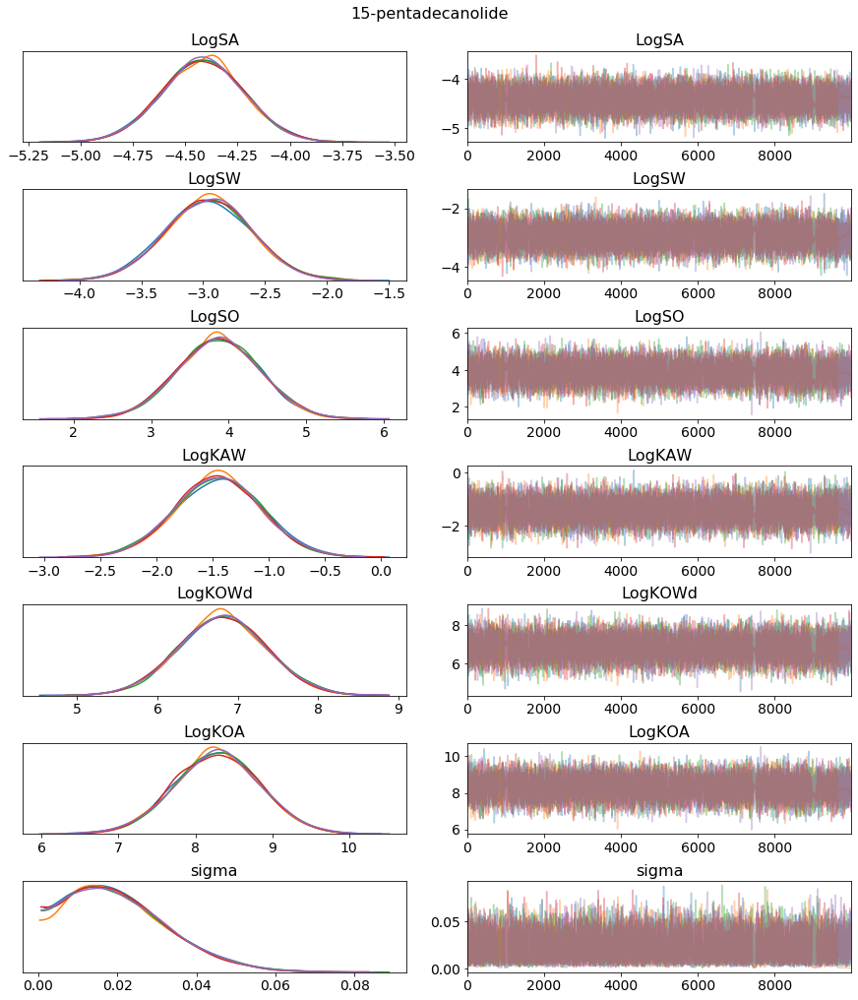

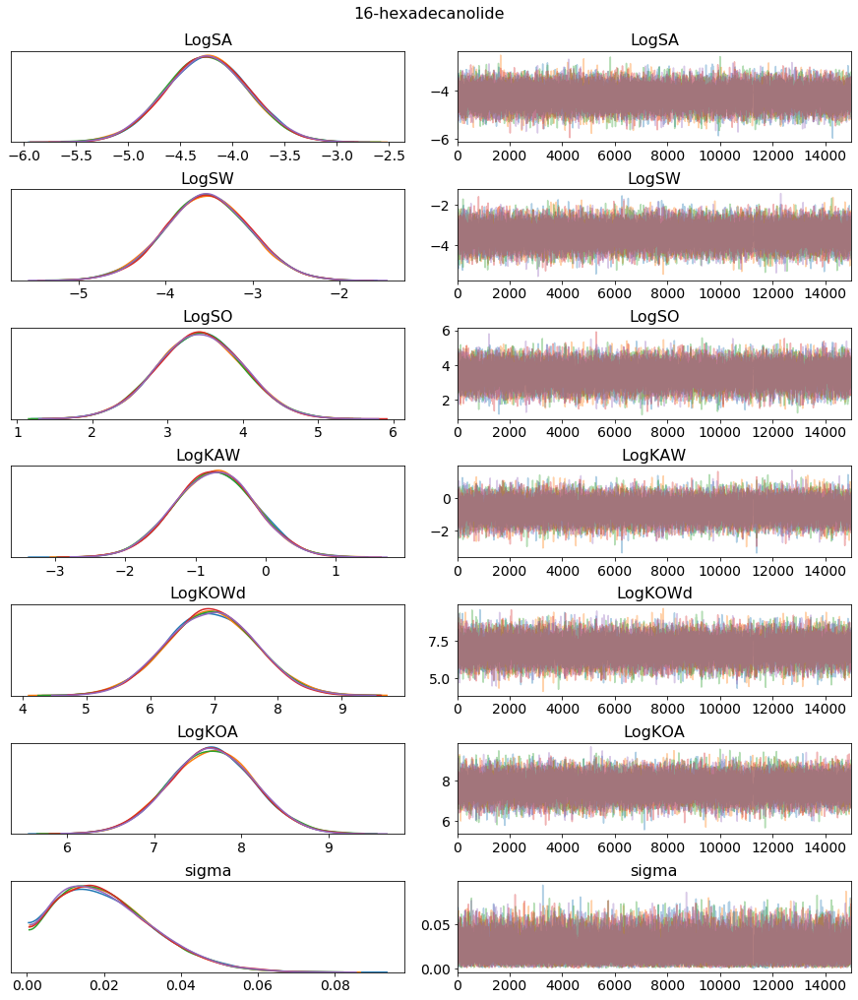

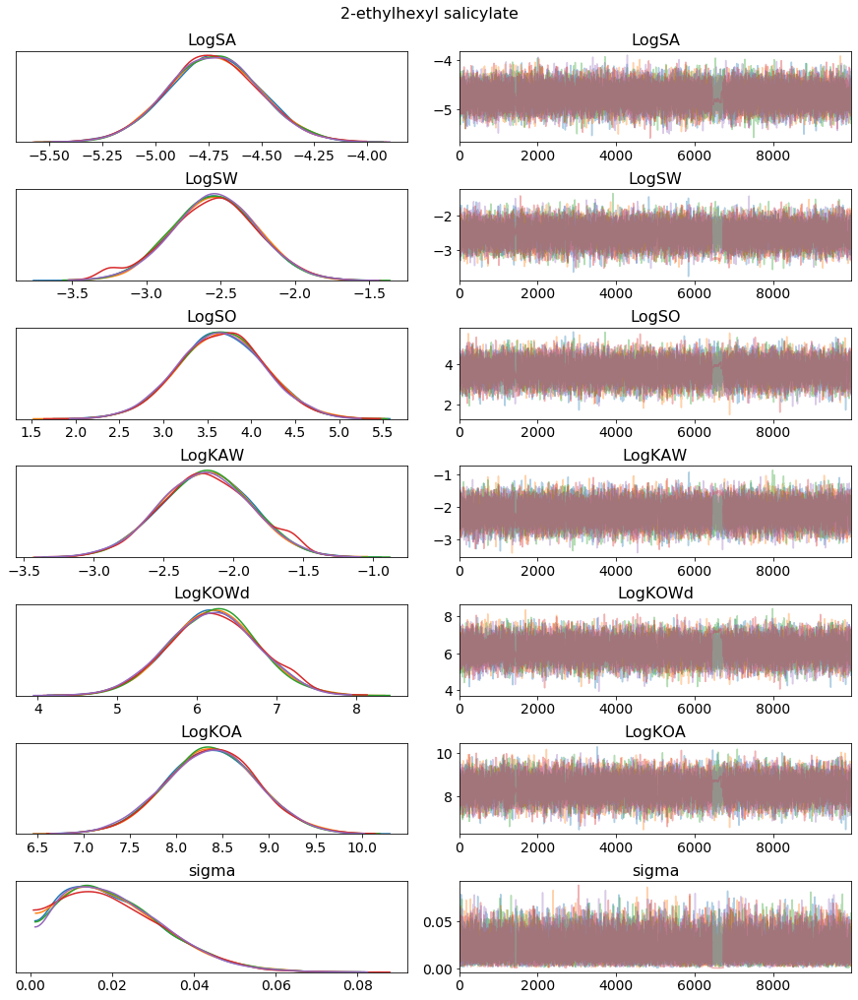

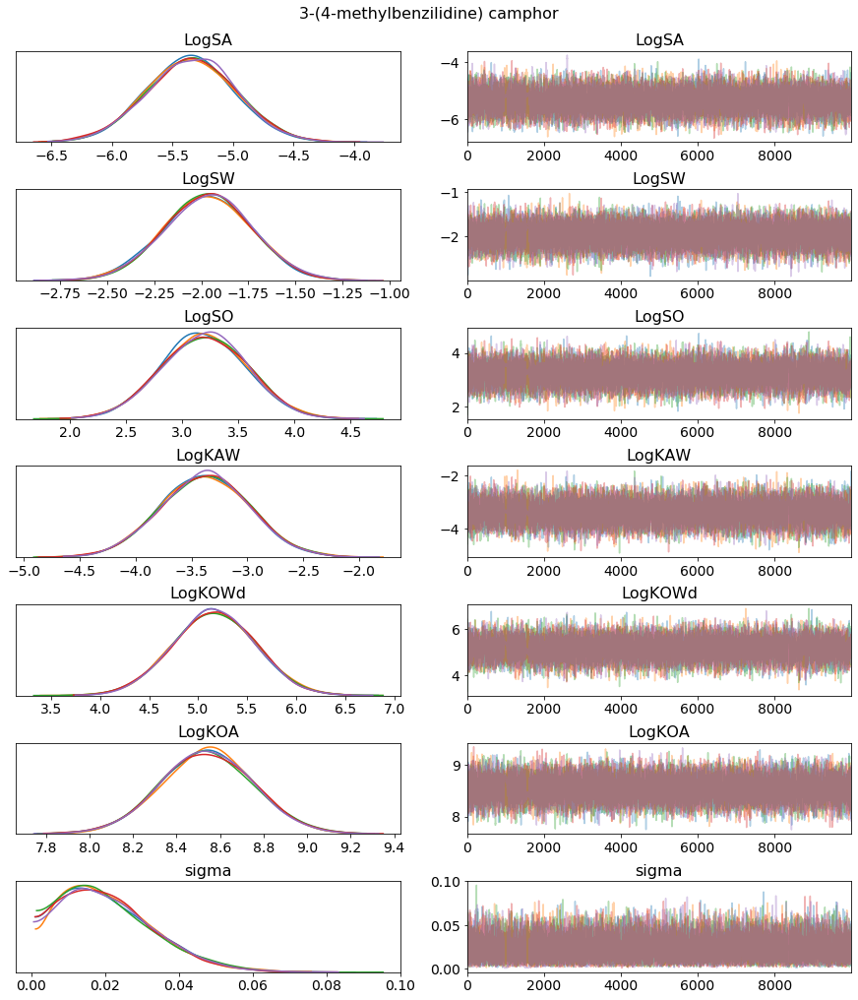

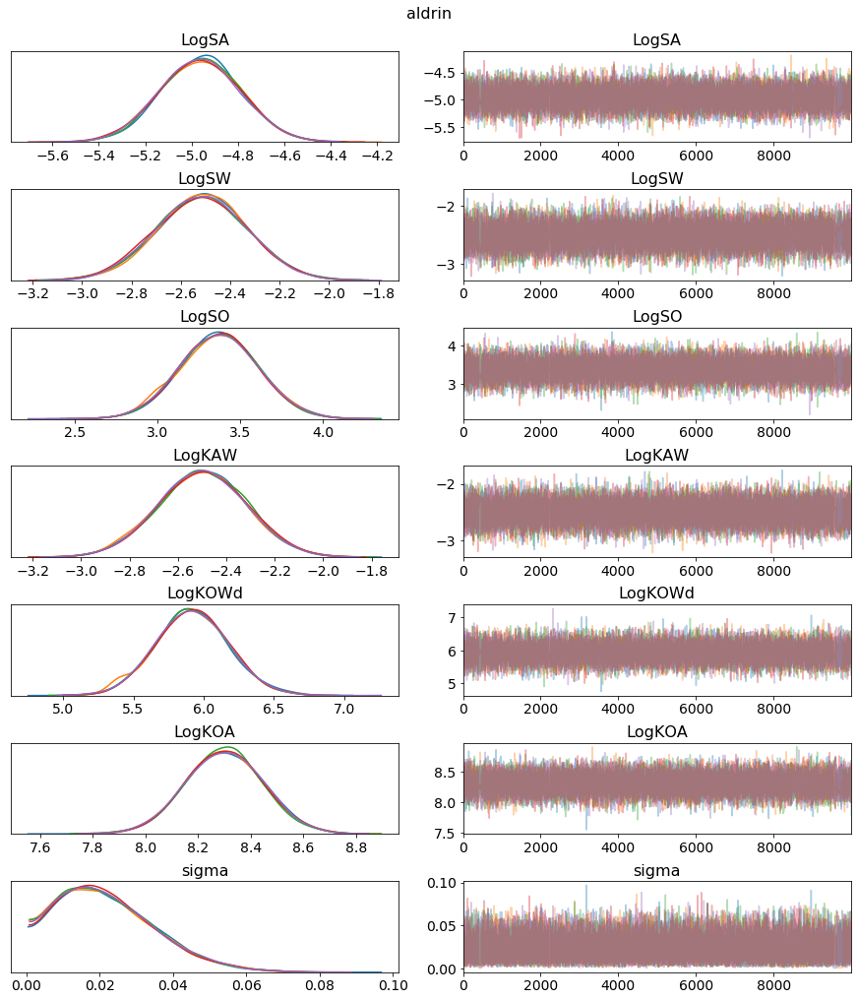

...

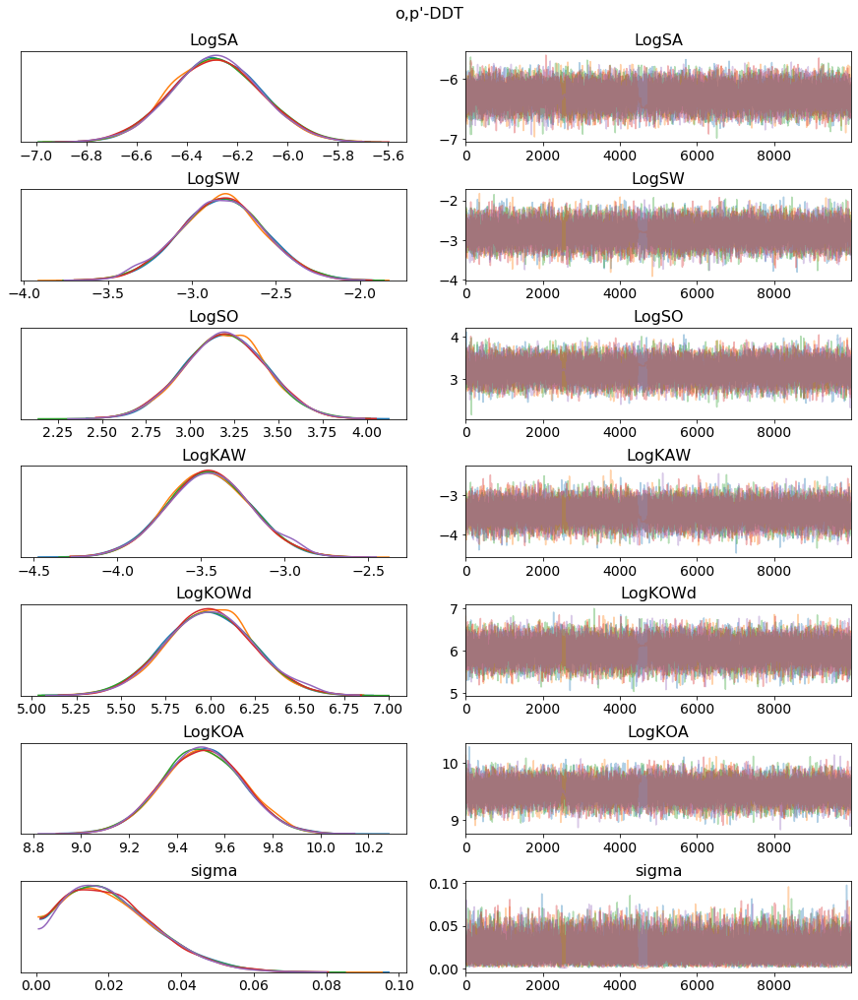

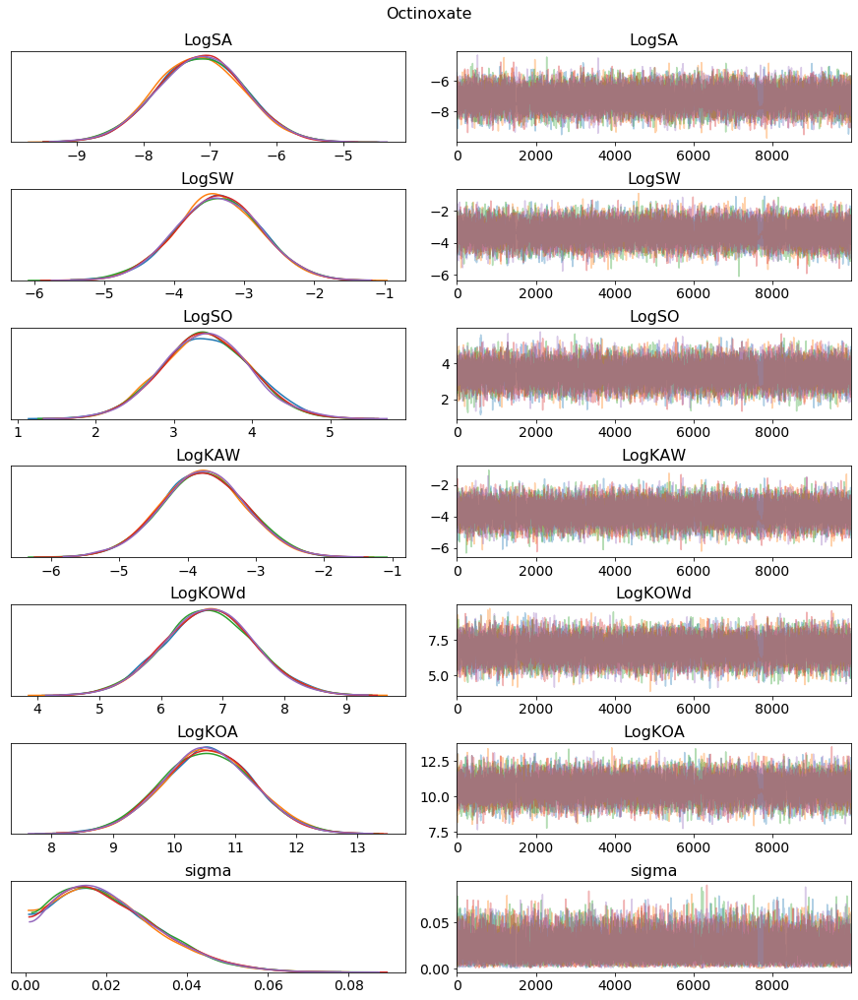

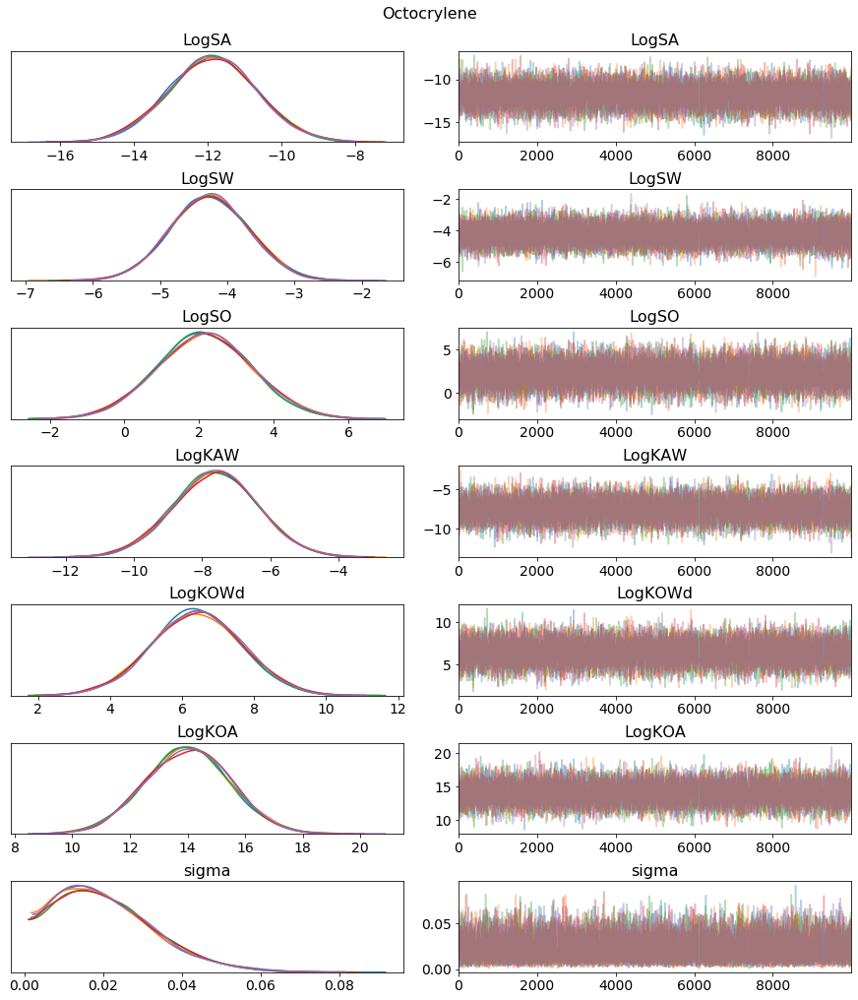

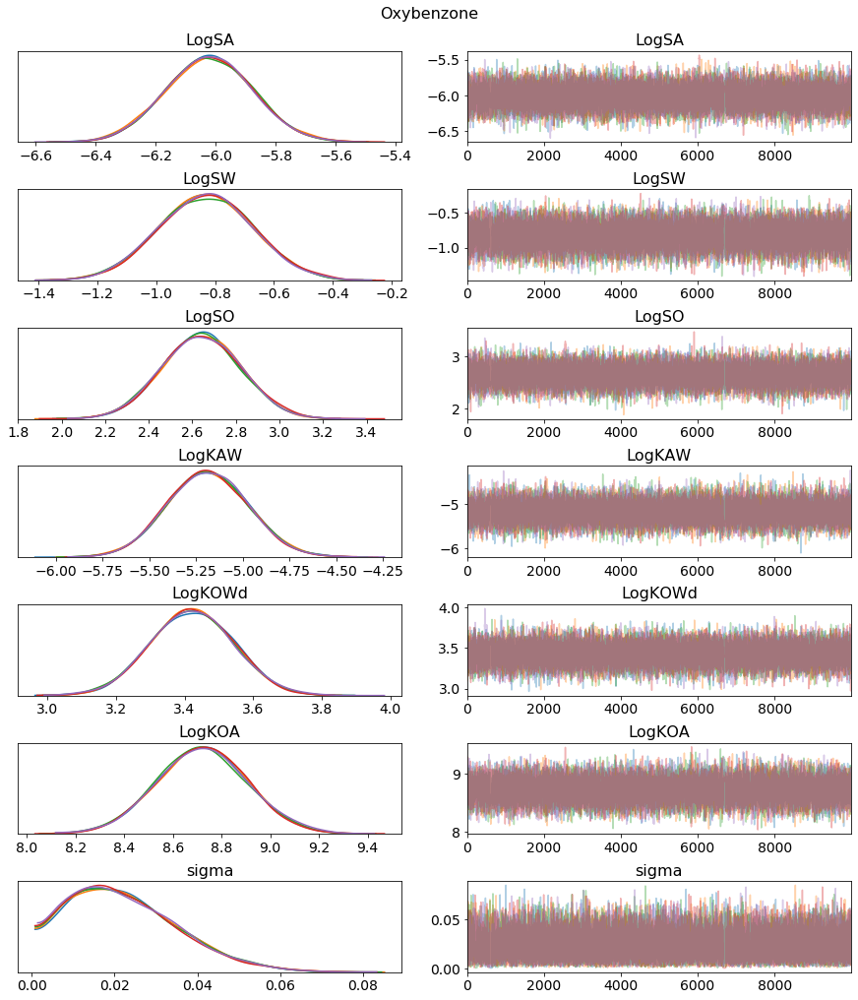

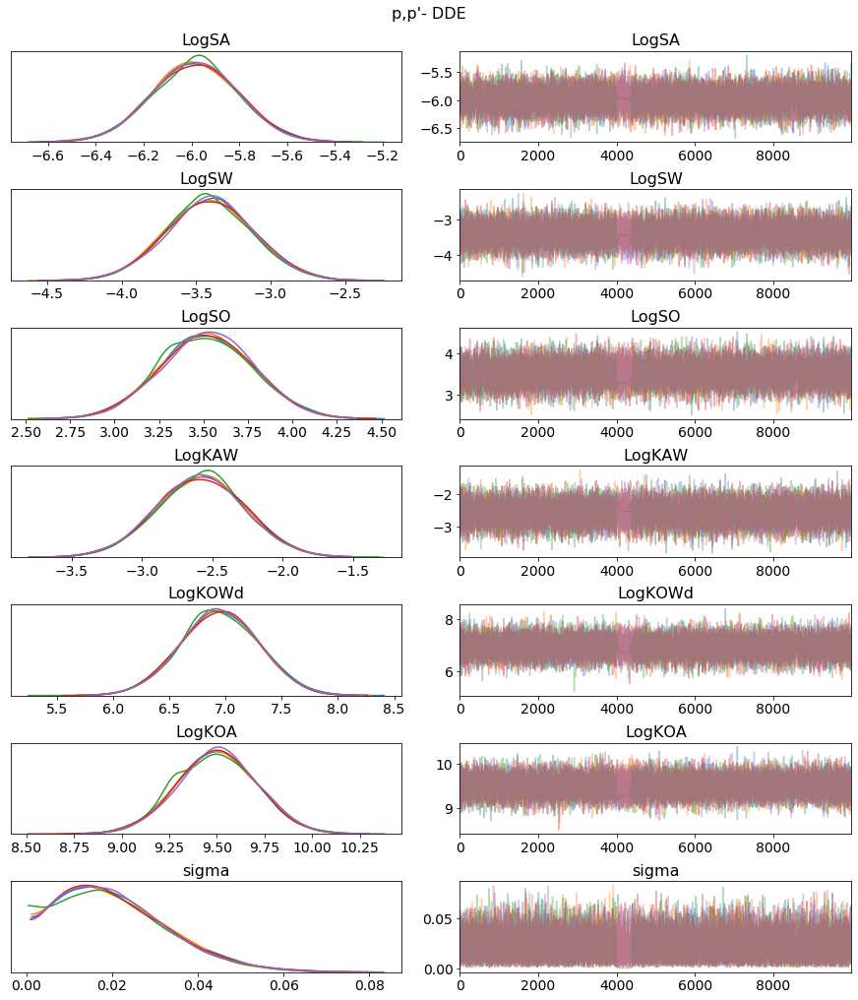

In [ ]:
#Check the traceplots
directory = 'Traces/FAVRs/KS/'
#Loop through all the files in the directory and display plots. You may want to change the directory to a
#sub-folder if you are running lots of compounds. This may take ~minutes for lots of plots. 
#Also note that opening lots of plots take a lot of memory-you may get a memory error depending on your RAM.
for filename in os.listdir(directory):
    #Define the compound from the filename
    #pdb.set_trace()
    comp = filename[0:filename.find("_")]
    if comp == "benzokfluoranthene": #Error from the square brackets in loading files
        comp = "benzo[k]fluoranthene"
    elif comp == "benzoapyrene":
        comp = "benzo[a]pyrene"
    try: 
        fig, tracesumm = fmf.plot_trace(comp,FAVRs,filename=directory+filename,uDV=uCDV,model_type = 'KS')
        #Put it in the FAV dataframe at the same time, just in case the kernel was reloaded at some point.
        FAVRs = fmf.trace_to_FAVs(comp,FAVRs,filename = directory+filename,uDV=uCDV,model_type='KS')
        #Print the compound name and the traceplot summary tables
        comp
        tracesumm
    except KeyError:
        #Subfolders in the directory will return a keyerror.
        pass

In [ ]:
InteractiveShell.ast_node_interactivity = 'last_expr'  

In [ ]:
#Look at the adjustments
comps = FAVRs.loc[FAVRs.loc[:,'LogSA']!=0,:].index
KSnames = ['LogSA','LogSW','LogSO','LogKAW','LogKOWd','LogKOA']
for prop in KSnames:
    FAVRs.loc[comps,'e_'+prop] = uLDV.loc[comps,prop]-FAVRs.loc[comps,prop] 
#Display
FAVRs.loc[comps,'e_LogSA':'e_LogKOA']

In [ ]:
#Then we export the FAVs to a CSV file in the parent directory. Change the savename to include a folder if 
#you want to save in a specific folder.
KSFAVRs_exp = fmf.export_FAVs(FAVRs,savename = 'FAVRs_KS')

Finally, we are done with the internal energies! Next we will do the partition coefficients and solubilities
in a separate Jupyter notebook, for convenience. You can use the FAVRs generated here for the internal
energies to temperature-correct any literature values you may have found not at 25°C for the partition 
coefficients and solubilities. The Excel template "Table S4" has equations that will pull from "Table S6"